# Introdução à Análise de Dados com Python
---

## Capítulo 4: Análise de Gastos com Passagens Aéreas (SCDP)

## Informações
* Origem dos dados
```
Portal da Transparência (http://transparencia.gov.br/download-de-dados/viagens)
```
* Dicionário de dados
```
http://transparencia.gov.br/pagina-interna/603364-dicion%C3%A1rio-de-dados-viagens-a-Servi%C3%A7o-Pagamentos
```
* 4 arquivos:
    * 2018_Pagamento.csv
    * 2018_Passagem.csv
    * 2018_Trecho.csv
    * 2018_Viagem.csv

## Perguntas a serem respondidas?

* Qual o trecho mais executado?
* Qual o valor médio para o trecho mais executado?
* Qual a mediana para o trecho mais executado?
* Identificar possíveis outliers nos valores do trecho mais executado

In [1]:
import pandas as pd
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns

pd.set_option('display.max_columns', 500)
pd.set_option('display.max_colwidth', 1000)
pd.set_option('display.float_format', lambda x: '{:.2f}'.format(x))

plt.rcParams['figure.dpi'] = 90

# Leitura dos Dados
---

In [2]:
"""
Leia o arquivo
'dados/c04_passagens/2018_Passagem.csv.zip'
"""
df_passagens = pd.read_csv('dados/c04_passagens/2018_Passagem.csv.zip', 
                           sep=';', 
                           encoding='iso-8859-1'
                          )

df_passagens.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço
0,14046485,Rodoviário,Brasil,Ceará,Fortaleza,Brasil,Ceará,Sobral,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,"40,95","13,51"
1,14046485,Rodoviário,Brasil,Ceará,Sobral,Brasil,Ceará,Fortaleza,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,"33,25","10,97"
2,14166390,Aéreo,Brasil,Paraná,Londrina,Brasil,Mato Grosso,Sinop,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,"518,09",",00"
3,14166390,Aéreo,Brasil,Mato Grosso,Sinop,Brasil,Paraná,Londrina,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,"665,38",",00"
4,14201345,Aéreo,Brasil,Paraná,Curitiba,Brasil,Rio Grande do Sul,Porto Alegre,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,"369,30",",00"


# Identificação de valores nulos ou faltantes
---

In [3]:
df_passagens.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 310816 entries, 0 to 310815
Data columns (total 16 columns):
Identificador do processo de viagem    310816 non-null int64
Meio de transporte                     310816 non-null object
País - Origem ida                      310816 non-null object
UF - Origem ida                        303560 non-null object
Cidade - Origem ida                    310816 non-null object
País - Destino ida                     310816 non-null object
UF - Destino ida                       301096 non-null object
Cidade - Destino ida                   310816 non-null object
País - Origem volta                    310816 non-null object
UF - Origem volta                      307823 non-null object
Cidade - Origem volta                  310816 non-null object
Pais - Destino volta                   310816 non-null object
UF - Destino volta                     310234 non-null object
Cidade - Destino volta                 310816 non-null object
Valor da passagem     

In [4]:
"""
Vamos verificar algumas estatísticas básicas sobre colunas numéricas.
"""

df_passagens.describe()

,Identificador do processo de viagem
count,310816.00
mean,34950773.58
std,199220763.01
min,14046485.00
25%,14763521.75
50%,14929268.00
75%,15105045.00
max,2018002771.00


In [5]:
"""
Vamos verificar algumas estatísticas básicas sobre as demais colunas.
"""

df_passagens.describe(include='object')

,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço
count,310816,310816,303560,310816,310816,301096,310816,310816,307823,310816,310816,310234,310816,310816,310816
unique,4,163,28,913,162,28,997,111,28,541,103,28,352,72794,1641
top,Aéreo,Brasil,Distrito Federal,Brasília,Brasil,Distrito Federal,Brasília,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,Sem Informação,",00",",00"
freq,293475,303557,80478,80478,301093,79346,79346,287331,287331,287331,287331,287331,287331,3299,281439


In [6]:
"""
Tratamento em todas as colunas para colocar o valor None quando o valor for 'Não informado' ou NaN
"""
for c in df_passagens.columns:
    df_passagens[c] = df_passagens[c].apply(lambda x: x if x != 'Sem Informação' and pd.notnull(x) else None)

In [7]:
df_passagens.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 310816 entries, 0 to 310815
Data columns (total 16 columns):
Identificador do processo de viagem    310816 non-null int64
Meio de transporte                     310816 non-null object
País - Origem ida                      310816 non-null object
UF - Origem ida                        303560 non-null object
Cidade - Origem ida                    310816 non-null object
País - Destino ida                     310816 non-null object
UF - Destino ida                       301096 non-null object
Cidade - Destino ida                   310816 non-null object
País - Origem volta                    23485 non-null object
UF - Origem volta                      20492 non-null object
Cidade - Origem volta                  23485 non-null object
Pais - Destino volta                   23485 non-null object
UF - Destino volta                     22903 non-null object
Cidade - Destino volta                 23485 non-null object
Valor da passagem           

# Conversão das colunas para os tipos de dados corretos e padronização campos
---

In [8]:
"""
Verificamos valores nulos e tipos de dados com o método info() do dataframe.
"""

df_passagens.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 310816 entries, 0 to 310815
Data columns (total 16 columns):
Identificador do processo de viagem    310816 non-null int64
Meio de transporte                     310816 non-null object
País - Origem ida                      310816 non-null object
UF - Origem ida                        303560 non-null object
Cidade - Origem ida                    310816 non-null object
País - Destino ida                     310816 non-null object
UF - Destino ida                       301096 non-null object
Cidade - Destino ida                   310816 non-null object
País - Origem volta                    23485 non-null object
UF - Origem volta                      20492 non-null object
Cidade - Origem volta                  23485 non-null object
Pais - Destino volta                   23485 non-null object
UF - Destino volta                     22903 non-null object
Cidade - Destino volta                 23485 non-null object
Valor da passagem           

In [9]:
"""
A conversão pode ser feita utilizando o método apply da série que deseja converter.
"""
def converter_numero(valor):
    try:
        return float(valor.replace('.', '').replace(',', '.'))
    except:
        return np.nan

df_passagens_1 = df_passagens.copy()
df_passagens_1['Valor da passagem'] = df_passagens_1['Valor da passagem'].apply(converter_numero,)
df_passagens_1['Taxa de serviço'] = df_passagens_1['Taxa de serviço'].apply(converter_numero)

In [10]:
df_passagens_1[['Valor da passagem', 'Taxa de serviço']].head()

,Valor da passagem,Taxa de serviço
0,40.95,13.51
1,33.25,10.97
2,518.09,0.00
3,665.38,0.00
4,369.30,0.00


In [11]:
df_passagens_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 310816 entries, 0 to 310815
Data columns (total 16 columns):
Identificador do processo de viagem    310816 non-null int64
Meio de transporte                     310816 non-null object
País - Origem ida                      310816 non-null object
UF - Origem ida                        303560 non-null object
Cidade - Origem ida                    310816 non-null object
País - Destino ida                     310816 non-null object
UF - Destino ida                       301096 non-null object
Cidade - Destino ida                   310816 non-null object
País - Origem volta                    23485 non-null object
UF - Origem volta                      20492 non-null object
Cidade - Origem volta                  23485 non-null object
Pais - Destino volta                   23485 non-null object
UF - Destino volta                     22903 non-null object
Cidade - Destino volta                 23485 non-null object
Valor da passagem           

In [12]:
"""
Padronização das strings é interessante para que a ausência ou a presença de acentos não interfira em agrupamentos.
"""

from libs.texto import TratamentoTexto
def tratar_texto(valor):
    v = valor
    
    # somente realiza o tratamento se o texto não for nulo
    if v:
        # remove acentuação
        v = TratamentoTexto.remover_acentuacao(v)
        # converte para letras maiúsculas
        v = v.upper()
        
    return v

colunas = ['Meio de transporte',
       'País - Origem ida', 'UF - Origem ida', 'Cidade - Origem ida',
       'País - Destino ida', 'UF - Destino ida', 'Cidade - Destino ida',
       'País - Origem volta', 'UF - Origem volta', 'Cidade - Origem volta',
       'Pais - Destino volta', 'UF - Destino volta', 'Cidade - Destino volta']

# padronize as colunas da lista acima no dataframe df_passagens_1
for c in colunas:
    df_passagens_1[c] = df_passagens_1[c].apply(tratar_texto)

df_passagens_1.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço
0,14046485,RODOVIARIO,BRASIL,CEARA,FORTALEZA,BRASIL,CEARA,SOBRAL,None,None,None,None,None,None,40.95,13.51
1,14046485,RODOVIARIO,BRASIL,CEARA,SOBRAL,BRASIL,CEARA,FORTALEZA,None,None,None,None,None,None,33.25,10.97
2,14166390,AEREO,BRASIL,PARANA,LONDRINA,BRASIL,MATO GROSSO,SINOP,None,None,None,None,None,None,518.09,0.00
3,14166390,AEREO,BRASIL,MATO GROSSO,SINOP,BRASIL,PARANA,LONDRINA,None,None,None,None,None,None,665.38,0.00
4,14201345,AEREO,BRASIL,PARANA,CURITIBA,BRASIL,RIO GRANDE DO SUL,PORTO ALEGRE,None,None,None,None,None,None,369.30,0.00


# Você já está pensando em responder as questões?

Não é uma boa idéia na maioria dos casos.

In [13]:
colunas_gb = ['País - Origem ida', 'UF - Origem ida', 'Cidade - Origem ida',
       'País - Destino ida', 'UF - Destino ida', 'Cidade - Destino ida']

colunas_selecao = ['País - Origem ida', 'UF - Origem ida', 'Cidade - Origem ida',
       'País - Destino ida', 'UF - Destino ida', 'Cidade - Destino ida', 'Valor da passagem']

df_passagens_1[colunas_selecao].groupby(colunas_gb, as_index=False).agg(['count', 'mean', 'median']).sort_values(('Valor da passagem', 'count'), ascending=False).head(10)

Valor da passagem  \
                                                                                                                              count   
País - Origem ida UF - Origem ida   Cidade - Origem ida País - Destino ida UF - Destino ida  Cidade - Destino ida                     
BRASIL            RIO DE JANEIRO    RIO DE JANEIRO      BRASIL             DISTRITO FEDERAL  BRASILIA                         14034   
                  DISTRITO FEDERAL  BRASILIA            BRASIL             RIO DE JANEIRO    RIO DE JANEIRO                   13933   
                                                                           SAO PAULO         SAO PAULO                        12271   
                  SAO PAULO         SAO PAULO           BRASIL             DISTRITO FEDERAL  BRASILIA                         12027   
                  RIO GRANDE DO SUL PORTO ALEGRE        BRASIL             DISTRITO FEDERAL  BRASILIA                          4092   
                  DISTRITO FEDERAL  BRASILIA            BRASIL             RIO GRANDE DO SUL PORTO ALEGRE                      3980   
                  RIO DE JANEIRO    RIO DE JANEIRO      BRASIL             SAO PAULO         SAO PAULO                         3603   
                  DISTRITO FEDERAL  BRASILIA            BRASIL             MINAS GERAIS      BELO HORIZONTE                    3535   
                  MINAS GERAIS      BELO HORIZONTE      BRASIL             DISTRITO FEDERAL  BRASILIA                          3499   
                  SAO PAULO         SAO PAULO           BRASIL             RIO DE JANEIRO    RIO DE JANEIRO                    3459   

                                                                                                                          \
                                                                                                                    mean   
País - Origem ida UF - Origem ida   Cidade - Origem ida País - Destino ida UF - Destino ida  Cidade - Destino ida          
BRASIL            RIO DE JANEIRO    RIO DE JANEIRO      BRASIL             DISTRITO FEDERAL  BRASILIA             665.59   
                  DISTRITO FEDERAL  BRASILIA            BRASIL             RIO DE JANEIRO    RIO DE JANEIRO       621.79   
                                                                           SAO PAULO         SAO PAULO            696.73   
                  SAO PAULO         SAO PAULO           BRASIL             DISTRITO FEDERAL  BRASILIA             685.14   
                  RIO GRANDE DO SUL PORTO ALEGRE        BRASIL             DISTRITO FEDERAL  BRASILIA             767.78   
                  DISTRITO FEDERAL  BRASILIA            BRASIL             RIO GRANDE DO SUL PORTO ALEGRE         713.10   
                  RIO DE JANEIRO    RIO DE JANEIRO      BRASIL             SAO PAULO         SAO PAULO            354.40   
                  DISTRITO FEDERAL  BRASILIA            BRASIL             MINAS GERAIS      BELO HORIZONTE       643.77   
                  MINAS GERAIS      BELO HORIZONTE      BRASIL             DISTRITO FEDERAL  BRASILIA             643.06   
                  SAO PAULO         SAO PAULO           BRASIL             RIO DE JANEIRO    RIO DE JANEIRO       342.41   

                                                                                                                          
                                                                                                                  median  
País - Origem ida UF - Origem ida   Cidade - Origem ida País - Destino ida UF - Destino ida  Cidade - Destino ida         
BRASIL            RIO DE JANEIRO    RIO DE JANEIRO      BRASIL             DISTRITO FEDERAL  BRASILIA             567.11  
                  DISTRITO FEDERAL  BRASILIA            BRASIL             RIO DE JANEIRO    RIO DE JANEIRO       527.03  
                                                                           SAO PAULO         SAO PAULO            559.69  
       

# Entendimento e organização dos dados

Vamos olhar as variáveis de interesse separadamente.

## Identificador do processo de viagem

In [14]:
df_passagens_1['Identificador do processo de viagem'].value_counts().value_counts()


2     117098
1      40411
3       6338
4       3436
5        319
6        187
7         42
8         36
10         5
9          3
14         2
11         2
13         1
12         1
Name: Identificador do processo de viagem, dtype: int64

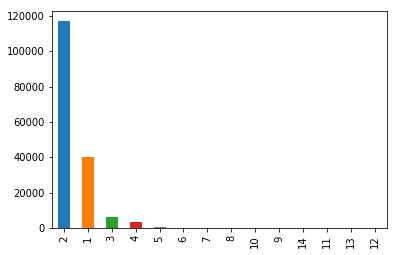

In [15]:
df_passagens_1['Identificador do processo de viagem'].value_counts().value_counts().plot.bar()

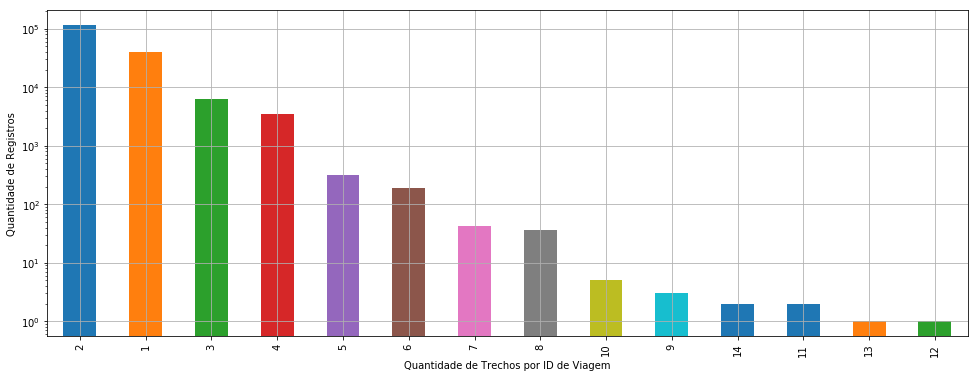

In [16]:
plt.rcParams['figure.figsize'] = (16.5,6)
df_passagens_1['Identificador do processo de viagem'].value_counts().value_counts().plot.bar()
plt.xlabel('Quantidade de Trechos por ID de Viagem')
plt.ylabel('Quantidade de Registros')
plt.yscale('log')
plt.grid(True)
plt.show()

In [17]:
'''
Exemplo de uma viagem com 3 trechos
'''
df_passagens_1[ df_passagens_1['Identificador do processo de viagem'] == 14756123 ]

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço
74183,14756123,AEREO,BRASIL,CEARA,FORTALEZA,BRASIL,BAHIA,SALVADOR,None,None,None,None,None,None,285.86,0.00
74184,14756123,AEREO,BRASIL,BAHIA,SALVADOR,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,368.31,0.00
74185,14756123,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,CEARA,FORTALEZA,None,None,None,None,None,None,552.33,0.00


In [18]:
'''
Exemplo de uma viagem com 5 trechos
'''
df_passagens_1[ df_passagens_1['Identificador do processo de viagem'] == 14825056 ]

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço
106975,14825056,AEREO,ESTADOS UNIDOS DA AMERICA,None,MIAMI,ESTADOS UNIDOS DA AMERICA,None,CHARLOTTE - CAROLINA DO NORTE,None,None,None,None,None,None,1762.05,0.00
106976,14825056,AEREO,ESTADOS UNIDOS DA AMERICA,None,MIAMI,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,1812.01,0.00
106977,14825056,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,ESTADOS UNIDOS DA AMERICA,None,MIAMI,None,None,None,None,None,None,1762.05,0.00
106978,14825056,AEREO,ESTADOS UNIDOS DA AMERICA,None,INDIANAPOLIS,ESTADOS UNIDOS DA AMERICA,None,MIAMI,None,None,None,None,None,None,1762.05,0.00
106979,14825056,AEREO,ESTADOS UNIDOS DA AMERICA,None,CHARLOTTE - CAROLINA DO NORTE,ESTADOS UNIDOS DA AMERICA,None,INDIANAPOLIS,None,None,None,None,None,None,1762.05,0.00


In [19]:
'''
Exemplo de uma viagem com 14 trechos
'''
df_passagens_1[ df_passagens_1['Identificador do processo de viagem'] == 15190575 ]

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço
262511,15190575,AEREO,FILIPINAS,None,MANILLA,COREIA DO SUL,None,SEUL,None,None,None,None,None,None,1449.92,0.00
262512,15190575,AEREO,TAILANDIA,None,BANGCOC,LAOS,None,VIENTIANE,None,None,None,None,None,None,1685.39,0.00
262513,15190575,AEREO,LAOS,None,VIENTIANE,TAILANDIA,None,BANGCOC,None,None,None,None,None,None,0.00,0.00
262514,15190575,AEREO,TAILANDIA,None,BANGCOC,MYANMAR,None,NAY PYI TAW,None,None,None,None,None,None,1425.89,0.00
262515,15190575,AEREO,MYANMAR,None,YANGON,FILIPINAS,None,MANILLA,None,None,None,None,None,None,4305.86,0.00
262516,15190575,AEREO,BRASIL,SAO PAULO,SAO PAULO,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,393.66,0.00
262517,15190575,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,SAO PAULO,SAO PAULO,None,None,None,None,None,None,1145.17,0.00
262518,15190575,AEREO,COREIA DO SUL,None,SEUL,MONGOLIA,None,ULAN-BATOR,None,None,None,None,None,None,1403.02,0.00
262519,15190575,AEREO,MYANMAR,None,NAY PYI TAW,MYANMAR,None,YANGON,None,None,None,None,None,None,608.52,0.00
262520,15190575,AEREO,BRASIL,SAO PAULO,SAO PAULO,TAILANDIA,None,BANGCOC,None,None,None,None,None,None,5533.52,0.00


In [20]:
df_passagens_1.describe(include='all')

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço
count,310816.00,310816,310816,303560,310816,310816,301096,310816,23485,20492,23485,23485,22903,23485,310816.00,310816.00
unique,nan,4,148,28,912,146,28,996,99,27,540,101,27,351,nan,nan
top,nan,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,DISTRITO FEDERAL,BRASILIA,nan,nan
freq,nan,293475,303557,80478,80478,301093,79346,79346,20492,5513,5513,22903,7356,7356,nan,nan
mean,34950773.58,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,826.33,3.04
std,199220763.01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1061.66,67.42
min,14046485.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00
25%,14763521.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,368.78,0.00
50%,14929268.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,598.90,0.00
75%,15105045.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,946.43,0.00


In [21]:
"""
Vamos criar uma coluna que identifica se o trecho faz parte de uma viagem internacional ou não
"""

# vamos marcar trechos que são de origem ou destino internacional
df_passagens_1['Trecho Internacional'] = \
    (df_passagens_1['País - Origem ida'] != 'BRASIL') | (df_passagens_1['País - Destino ida'] != 'BRASIL') \
    | ( df_passagens_1['País - Origem volta'].notnull() & ((df_passagens_1['País - Origem volta'] != 'BRASIL') | (df_passagens_1['Pais - Destino volta'] != 'BRASIL'))) \

df_passagens_1[df_passagens_1['Trecho Internacional']].head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional
6,14223544,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BOLIVIA,None,SANTA CRUZ DE LA SIERRA,None,None,None,None,None,None,767.79,0.00,True
9,14263076,AEREO,BRASIL,SAO PAULO,SAO PAULO,CANADA,None,VANCOUVER,None,None,None,None,None,None,3635.74,0.00,True
16,14292724,AEREO,ESTADOS UNIDOS DA AMERICA,None,AUSTIN,INDIA,None,NOVA DELHI,INDIA,None,NOVA DELHI,ESTADOS UNIDOS DA AMERICA,None,AUSTIN,3637.35,0.00,True
17,14296742,AEREO,BRASIL,SAO PAULO,SAO PAULO,FILIPINAS,None,MANILLA,None,None,None,None,None,None,6108.06,0.00,True
18,14302981,AEREO,BRASIL,SAO PAULO,SAO PAULO,FILIPINAS,None,MANILLA,None,None,None,None,None,None,6117.92,0.00,True


In [22]:
df_passagens_1.shape

(310816, 17)

In [23]:
# quais viagens possuem ao menos um trecho internacional
df_viagens_internacionais = \
    df_passagens_1[['Identificador do processo de viagem','Trecho Internacional']]\
    .groupby('Identificador do processo de viagem', as_index=False)\
    .max()

df_viagens_internacionais.head()

,Identificador do processo de viagem,Trecho Internacional
0,14046485,False
1,14166390,False
2,14201345,False
3,14223544,True
4,14227023,False


# quais processos de viagem possuem trechos internacionais

In [24]:
df_viagens_internacionais = df_viagens_internacionais.rename(columns={'Trecho Internacional': 'Viagem Internacional'})
df_viagens_internacionais.head()

,Identificador do processo de viagem,Viagem Internacional
0,14046485,False
1,14166390,False
2,14201345,False
3,14223544,True
4,14227023,False


In [25]:
df_passagens_2 = pd.merge(df_passagens_1, df_viagens_internacionais, how='left', 
                          left_on='Identificador do processo de viagem', 
                          right_on='Identificador do processo de viagem')
df_passagens_2.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional
0,14046485,RODOVIARIO,BRASIL,CEARA,FORTALEZA,BRASIL,CEARA,SOBRAL,None,None,None,None,None,None,40.95,13.51,False,False
1,14046485,RODOVIARIO,BRASIL,CEARA,SOBRAL,BRASIL,CEARA,FORTALEZA,None,None,None,None,None,None,33.25,10.97,False,False
2,14166390,AEREO,BRASIL,PARANA,LONDRINA,BRASIL,MATO GROSSO,SINOP,None,None,None,None,None,None,518.09,0.00,False,False
3,14166390,AEREO,BRASIL,MATO GROSSO,SINOP,BRASIL,PARANA,LONDRINA,None,None,None,None,None,None,665.38,0.00,False,False
4,14201345,AEREO,BRASIL,PARANA,CURITIBA,BRASIL,RIO GRANDE DO SUL,PORTO ALEGRE,None,None,None,None,None,None,369.30,0.00,False,False


In [26]:
df_passagens_2[df_passagens_2['Identificador do processo de viagem'] == 14342418]


,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional
50,14342418,AEREO,BRASIL,MINAS GERAIS,GOVERNADOR VALADARES,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,None,None,None,None,None,None,496.60,0.00,False,True
51,14342418,AEREO,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,MINAS GERAIS,GOVERNADOR VALADARES,None,None,None,None,None,None,233.50,0.00,False,True
52,14342418,AEREO,ARGENTINA,None,BUENOS AIRES,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,None,None,None,None,None,None,1008.63,0.00,True,True
53,14342418,AEREO,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,ARGENTINA,None,BUENOS AIRES,None,None,None,None,None,None,1398.93,0.00,True,True


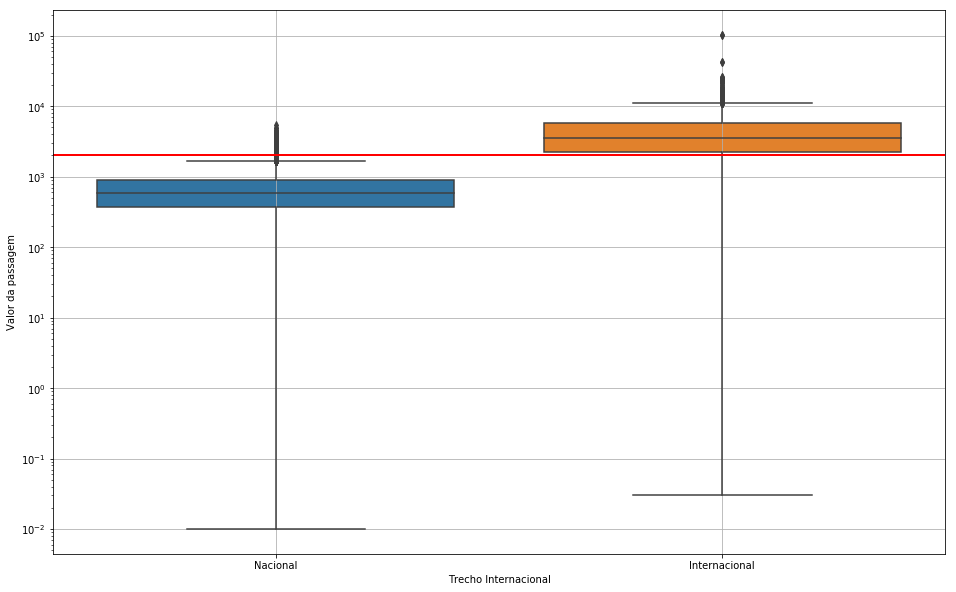

In [27]:
df_passagens_g = df_passagens_2[df_passagens_2['Valor da passagem'] > 0.001] 
plt.rcParams['figure.figsize'] = 16,10
ax = sns.boxplot(y=df_passagens_g['Valor da passagem'], x=df_passagens_g['Trecho Internacional'].apply(lambda x: 'Internacional' if x else 'Nacional'))
ax.set_yscale('log')
ax.plot([-1000, 1000], [2000,2000], color='red', linewidth=2, markersize=12)
plt.grid(True)
plt.show()

### Observações

* Número de trechos interfere no valor das passagens?
* Trechos domésticos e viagens internacionais possuem valor superior aos dos trechos domésticos em viagens nacionais?
* Trechos com valores muito baixos. Como isso é possível?

## Meio de transporte
---

In [28]:
df_passagens_1['Meio de transporte'].value_counts().to_frame()

,Meio de transporte
AEREO,293475
RODOVIARIO,14594
FLUVIAL,2733
FERROVIARIO,14


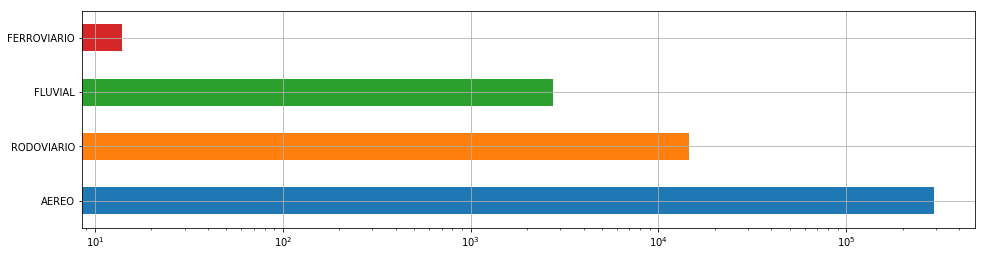

In [29]:
plt.rcParams["figure.figsize"] = 16, 4
ax = df_passagens_1['Meio de transporte'].value_counts().plot.barh()
ax.set_xscale('log')
plt.grid(True)
plt.show()

In [30]:
df_passagens_g['Meio de transporte'].drop_duplicates()

0          RODOVIARIO
2               AEREO
2225          FLUVIAL
100759    FERROVIARIO
Name: Meio de transporte, dtype: object

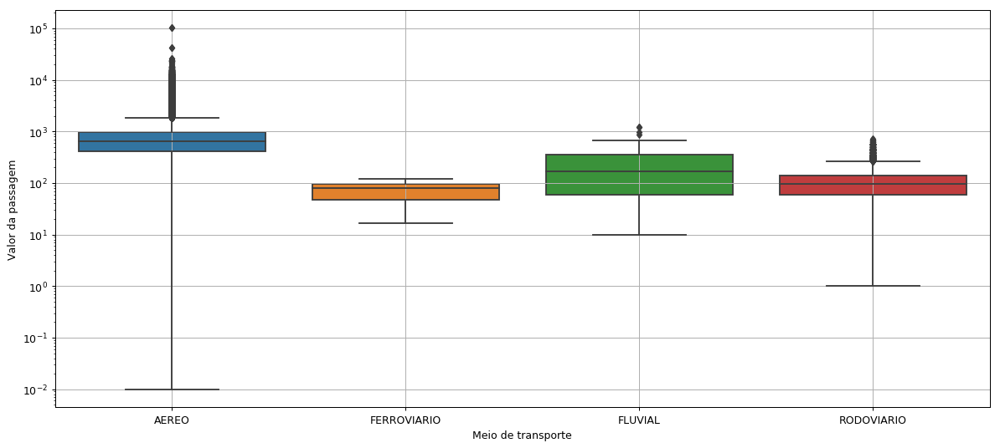

In [31]:
plt.rcParams['figure.figsize'] = 16,7
plt.rcParams['figure.dpi'] = 90

df_passagens_g = df_passagens_2[df_passagens_2['Valor da passagem']>0]

sns.boxplot(df_passagens_g['Meio de transporte'], df_passagens_g['Valor da passagem'], 
            order=df_passagens_g['Meio de transporte'].drop_duplicates().sort_values())
plt.yscale('log')
plt.ylim = [0, 150000]
plt.grid(True)
plt.show()

### Observações

* Trechos aéreos acompanhados de outras modalidades possuem valor diferenciado?
* Foco nos trechos aéreos

## Taxa de Serviço
---

In [32]:
"""
Muitos registros zerados.
""" 
df_passagens_1['Taxa de serviço'].value_counts().head()

0.00    281439
1.14      9121
0.01      4640
0.49      2043
5.00      1477
Name: Taxa de serviço, dtype: int64

In [33]:
df_passagens_1['Taxa de serviço'].describe().to_frame()

,Taxa de serviço
count,310816.00
mean,3.04
std,67.42
min,0.00
25%,0.00
50%,0.00
75%,0.00
max,8729.52


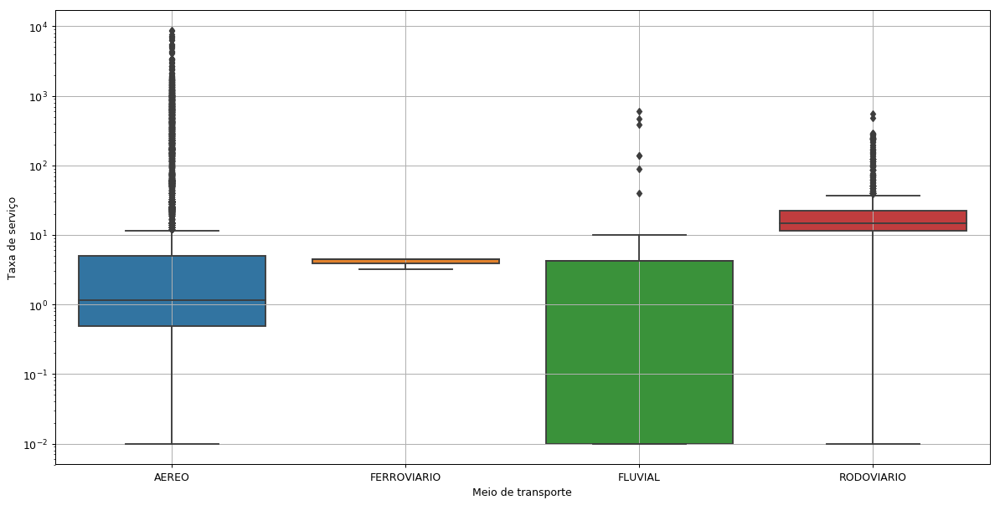

In [34]:
df_passagens_g = df_passagens_2[df_passagens_2['Taxa de serviço']>0]
plt.rcParams['figure.figsize'] = 16,8
sns.boxplot(x='Meio de transporte', y='Taxa de serviço', data=df_passagens_g, order=df_passagens_g['Meio de transporte'].drop_duplicates().sort_values())
plt.yscale('log')
plt.grid(True)
plt.show()

In [35]:
df_tx_n_zeradas = df_passagens_2[df_passagens_2['Taxa de serviço']>0]
df_tx_n_zeradas[['Meio de transporte', 'Taxa de serviço']].groupby('Meio de transporte').count()
del(df_tx_n_zeradas)

In [36]:
df_tx_n_zeradas = df_passagens_2[df_passagens_2['Taxa de serviço']>0]
df_tx_n_zeradas[['Meio de transporte', 'Taxa de serviço']].groupby('Meio de transporte').size()

Meio de transporte
AEREO          25041
FERROVIARIO        3
FLUVIAL          146
RODOVIARIO      4187
dtype: int64

In [37]:
df_tx_n_zeradas['Meio de transporte'].value_counts()

AEREO          25041
RODOVIARIO      4187
FLUVIAL          146
FERROVIARIO        3
Name: Meio de transporte, dtype: int64

### Observações

* Campo com poucas observações relevantes.
* Talvez seja interessante investigar os outliers com valores altos.
* Para o propósito levantado inicialmente, este campo não é necessário.

In [38]:
df_passagens_2.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional
0,14046485,RODOVIARIO,BRASIL,CEARA,FORTALEZA,BRASIL,CEARA,SOBRAL,None,None,None,None,None,None,40.95,13.51,False,False
1,14046485,RODOVIARIO,BRASIL,CEARA,SOBRAL,BRASIL,CEARA,FORTALEZA,None,None,None,None,None,None,33.25,10.97,False,False
2,14166390,AEREO,BRASIL,PARANA,LONDRINA,BRASIL,MATO GROSSO,SINOP,None,None,None,None,None,None,518.09,0.00,False,False
3,14166390,AEREO,BRASIL,MATO GROSSO,SINOP,BRASIL,PARANA,LONDRINA,None,None,None,None,None,None,665.38,0.00,False,False
4,14201345,AEREO,BRASIL,PARANA,CURITIBA,BRASIL,RIO GRANDE DO SUL,PORTO ALEGRE,None,None,None,None,None,None,369.30,0.00,False,False


## Origem, Destino, Ida e Volta

In [39]:
"""
Ocorrência da mesma variável em mais de uma coluna no dataset.
"""

df_passagens_2[df_passagens_2['Pais - Destino volta'].notnull()].head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional
10,14271222,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,DISTRITO FEDERAL,BRASILIA,286.24,0.00,False,False
15,14271373,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,SAO PAULO,SAO PAULO,BRASIL,SAO PAULO,SAO PAULO,BRASIL,DISTRITO FEDERAL,BRASILIA,230.59,0.00,False,False
16,14292724,AEREO,ESTADOS UNIDOS DA AMERICA,None,AUSTIN,INDIA,None,NOVA DELHI,INDIA,None,NOVA DELHI,ESTADOS UNIDOS DA AMERICA,None,AUSTIN,3637.35,0.00,True,True
21,14303414,AEREO,MEXICO,None,CIDADE DO MEXICO,NICARAGUA,None,MANAGUA,NICARAGUA,None,MANAGUA,MEXICO,None,CIDADE DO MEXICO,1738.17,0.00,True,True
22,14303414,AEREO,MEXICO,None,CIDADE DO MEXICO,NICARAGUA,None,MANAGUA,NICARAGUA,None,MANAGUA,MEXICO,None,CIDADE DO MEXICO,1736.03,0.00,True,True


In [40]:
"""
Vamos organizar.
"""

df_passagens_3 = df_passagens_2.copy()


In [41]:
df_passagens_3[df_passagens_3['País - Origem volta'].notnull()].shape

(23485, 18)

In [42]:
"""
Vamos quebrar as linhas que possuem os trachos de ida e volta.
"""

df_passagens_3['Tipo Trecho'] = 'IDA'
df_passagens_3['Tipo Compra'] = 'SEPARADA'

In [43]:
df_passagens_3.loc[[10]]

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra
10,14271222,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,DISTRITO FEDERAL,BRASILIA,286.24,0.00,False,False,IDA,SEPARADA


In [44]:
voltas = []

for idx, df in df_passagens_3[df_passagens_3['País - Origem volta'].notnull()].iterrows():
    print(idx)
    print(df)
    valor_passagem = df_passagens_3.at[idx, 'Valor da passagem'] / 2
    
    df_passagens_3.at[idx, 'Valor da passagem'] = valor_passagem
    df_passagens_3.at[idx, 'Tipo Compra'] = 'CONJUNTA'
    
    for ic in range(8,14):
        df_passagens_3.iat[idx, ic] = None
    
    df['Tipo Trecho'] = 'VOLTA'
    df['Tipo Compra'] = 'CONJUNTA'
    df['Valor da passagem'] = valor_passagem
    
    df['País - Origem ida'] = df['País - Origem volta']
    df['UF - Origem ida'] = df['UF - Origem volta']
    df['Cidade - Origem ida'] = df['Cidade - Origem volta']
    df['País - Destino ida'] = df['Pais - Destino volta']
    df['UF - Destino ida'] = df['UF - Destino volta']
    df['Cidade - Destino ida'] = df['Cidade - Destino volta']
    
    df['País - Origem volta'] = None
    df['UF - Origem volta'] = None
    df['Cidade - Origem volta'] = None
    df['Pais - Destino volta'] = None
    df['UF - Destino volta'] = None
    df['Cidade - Destino volta'] = None    
    
    voltas.append(df)
    
    

10
Identificador do processo de viagem            14271222
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                         RIO DE JANEIRO
Cidade - Destino ida                     RIO DE JANEIRO
País - Origem volta                              BRASIL
UF - Origem volta                        RIO DE JANEIRO
Cidade - Origem volta                    RIO DE JANEIRO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                                286.24
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                         

Name: 1987, dtype: object
1992
Identificador do processo de viagem            14557766
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                                SERGIPE
Cidade - Destino ida                            ARACAJU
País - Origem volta                              BRASIL
UF - Origem volta                               SERGIPE
Cidade - Origem volta                           ARACAJU
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                                902.21
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacio

Name: 3874, dtype: object
3880
Identificador do processo de viagem            14576560
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                   PIAUI
Cidade - Origem ida                            TERESINA
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                                PIAUI
Cidade - Destino volta                         TERESINA
Valor da passagem                               2726.42
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacio

Name: 5857, dtype: object
5871
Identificador do processo de viagem          14585048
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        RIO DE JANEIRO
Cidade - Origem ida                    RIO DE JANEIRO
País - Destino ida                          CINGAPURA
UF - Destino ida                                 None
Cidade - Destino ida                        CINGAPURA
País - Origem volta                         CINGAPURA
UF - Origem volta                                None
Cidade - Origem volta                       CINGAPURA
Pais - Destino volta                           BRASIL
UF - Destino volta                     RIO DE JANEIRO
Cidade - Destino volta                 RIO DE JANEIRO
Valor da passagem                             7088.98
Taxa de serviço                                  0.00
Trecho Internacional                             True
Viagem Internacional                             Tr

Name: 7221, dtype: object
7230
Identificador do processo de viagem            14590029
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                              SAO PAULO
Cidade - Destino ida                          SAO PAULO
País - Origem volta                              BRASIL
UF - Origem volta                             SAO PAULO
Cidade - Origem volta                         SAO PAULO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                                981.93
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacio

Identificador do processo de viagem            14596578
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                         RIO DE JANEIRO
Cidade - Destino ida                     RIO DE JANEIRO
País - Origem volta                              BRASIL
UF - Origem volta                        RIO DE JANEIRO
Cidade - Origem volta                    RIO DE JANEIRO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               1912.73
Taxa de serviço                                    3.00
Trecho Internacional                              False
Viagem Internacional                            

Name: 10929, dtype: object
10957
Identificador do processo de viagem             14601975
Meio de transporte                                 AEREO
País - Origem ida                                 BRASIL
UF - Origem ida                         DISTRITO FEDERAL
Cidade - Origem ida                             BRASILIA
País - Destino ida                                BRASIL
UF - Destino ida                                   CEARA
Cidade - Destino ida                   JUAZEIRO DO NORTE
País - Origem volta                               BRASIL
UF - Origem volta                                  CEARA
Cidade - Origem volta                  JUAZEIRO DO NORTE
Pais - Destino volta                              BRASIL
UF - Destino volta                      DISTRITO FEDERAL
Cidade - Destino volta                          BRASILIA
Valor da passagem                                 834.52
Taxa de serviço                                     0.00
Trecho Internacional                               Fals

Name: 12950, dtype: object
12956
Identificador do processo de viagem      14607840
Meio de transporte                     RODOVIARIO
País - Origem ida                          BRASIL
UF - Origem ida                             CEARA
Cidade - Origem ida                     FORTALEZA
País - Destino ida                         BRASIL
UF - Destino ida                            CEARA
Cidade - Destino ida                         OROS
País - Origem volta                        BRASIL
UF - Origem volta                           CEARA
Cidade - Origem volta                        OROS
Pais - Destino volta                       BRASIL
UF - Destino volta                          CEARA
Cidade - Destino volta                  FORTALEZA
Valor da passagem                           97.10
Taxa de serviço                             97.10
Trecho Internacional                        False
Viagem Internacional                        False
Tipo Trecho                                   IDA
Tipo Compra      

Name: 15922, dtype: object
15939
Identificador do processo de viagem            14616053
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                  PARANA
Cidade - Origem ida                            CURITIBA
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                               PARANA
Cidade - Destino volta                         CURITIBA
Valor da passagem                                564.10
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internac

18289
Identificador do processo de viagem            14623573
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                             MATO GROSSO
Cidade - Origem ida                              CUIABA
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                          MATO GROSSO
Cidade - Destino volta                           CUIABA
Valor da passagem                                981.60
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                      

20418
Identificador do processo de viagem            14629805
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               FRANCA
UF - Destino ida                                   None
Cidade - Destino ida                               NICE
País - Origem volta                              FRANCA
UF - Origem volta                                  None
Cidade - Origem volta                              NICE
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               4887.45
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Internacional                      

22065
Identificador do processo de viagem     14634969
Meio de transporte                         AEREO
País - Origem ida                         BRASIL
UF - Origem ida                         AMAZONAS
Cidade - Origem ida                       MANAUS
País - Destino ida                        BRASIL
UF - Destino ida                         RORAIMA
Cidade - Destino ida                   BOA VISTA
País - Origem volta                       BRASIL
UF - Origem volta                        RORAIMA
Cidade - Origem volta                  BOA VISTA
Pais - Destino volta                      BRASIL
UF - Destino volta                      AMAZONAS
Cidade - Destino volta                    MANAUS
Valor da passagem                        1914.34
Taxa de serviço                             0.00
Trecho Internacional                       False
Viagem Internacional                       False
Tipo Trecho                                  IDA
Tipo Compra                             SEPARADA
Name: 22065, d

Name: 24175, dtype: object
24176
Identificador do processo de viagem    14640520
Meio de transporte                        AEREO
País - Origem ida                        BRASIL
UF - Origem ida                            PARA
Cidade - Origem ida                       BELEM
País - Destino ida                       BRASIL
UF - Destino ida                           PARA
Cidade - Destino ida                   SANTAREM
País - Origem volta                      BRASIL
UF - Origem volta                          PARA
Cidade - Origem volta                  SANTAREM
Pais - Destino volta                     BRASIL
UF - Destino volta                         PARA
Cidade - Destino volta                    BELEM
Valor da passagem                        673.53
Taxa de serviço                            0.00
Trecho Internacional                      False
Viagem Internacional                      False
Tipo Trecho                                 IDA
Tipo Compra                            SEPARADA
Name: 2

25442
Identificador do processo de viagem             14643109
Meio de transporte                                 AEREO
País - Origem ida                                 BRASIL
UF - Origem ida                        RIO GRANDE DO SUL
Cidade - Origem ida                         PORTO ALEGRE
País - Destino ida                                BRASIL
UF - Destino ida                        DISTRITO FEDERAL
Cidade - Destino ida                            BRASILIA
País - Origem volta                               BRASIL
UF - Origem volta                       DISTRITO FEDERAL
Cidade - Origem volta                           BRASILIA
Pais - Destino volta                              BRASIL
UF - Destino volta                     RIO GRANDE DO SUL
Cidade - Destino volta                      PORTO ALEGRE
Valor da passagem                                1919.61
Taxa de serviço                                    14.00
Trecho Internacional                               False
Viagem Internacional     

26788
Identificador do processo de viagem       14646493
Meio de transporte                           AEREO
País - Origem ida                           BRASIL
UF - Origem ida                             PARANA
Cidade - Origem ida                       CURITIBA
País - Destino ida                       ARGENTINA
UF - Destino ida                              None
Cidade - Destino ida                   RESISTENCIA
País - Origem volta                      ARGENTINA
UF - Origem volta                             None
Cidade - Origem volta                  RESISTENCIA
Pais - Destino volta                        BRASIL
UF - Destino volta                          PARANA
Cidade - Destino volta                    CURITIBA
Valor da passagem                          3689.58
Taxa de serviço                               0.00
Trecho Internacional                          True
Viagem Internacional                          True
Tipo Trecho                                    IDA
Tipo Compra              

28887
Identificador do processo de viagem            14652885
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                              SAO PAULO
Cidade - Destino ida                          SAO PAULO
País - Origem volta                              BRASIL
UF - Origem volta                             SAO PAULO
Cidade - Origem volta                         SAO PAULO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               2534.10
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                      

Name: 30363, dtype: object
30372
Identificador do processo de viagem            14657583
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                           MINAS GERAIS
Cidade - Destino ida                            CONFINS
País - Origem volta                              BRASIL
UF - Origem volta                          MINAS GERAIS
Cidade - Origem volta                           CONFINS
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               1434.36
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internac

31786
Identificador do processo de viagem                 14661568
Meio de transporte                                RODOVIARIO
País - Origem ida                                     BRASIL
UF - Origem ida                                  MATO GROSSO
Cidade - Origem ida                    CAMPO NOVO DO PARECIS
País - Destino ida                                    BRASIL
UF - Destino ida                                 MATO GROSSO
Cidade - Destino ida                                  CUIABA
País - Origem volta                                   BRASIL
UF - Origem volta                                MATO GROSSO
Cidade - Origem volta                                 CUIABA
Pais - Destino volta                                  BRASIL
UF - Destino volta                               MATO GROSSO
Cidade - Destino volta                 CAMPO NOVO DO PARECIS
Valor da passagem                                     204.98
Taxa de serviço                                         0.00
Trecho Internacion

34053
Identificador do processo de viagem             14667142
Meio de transporte                                 AEREO
País - Origem ida                                 BRASIL
UF - Origem ida                        RIO GRANDE DO SUL
Cidade - Origem ida                         PORTO ALEGRE
País - Destino ida                                BRASIL
UF - Destino ida                        DISTRITO FEDERAL
Cidade - Destino ida                            BRASILIA
País - Origem volta                               BRASIL
UF - Origem volta                       DISTRITO FEDERAL
Cidade - Origem volta                           BRASILIA
Pais - Destino volta                              BRASIL
UF - Destino volta                     RIO GRANDE DO SUL
Cidade - Destino volta                      PORTO ALEGRE
Valor da passagem                                 543.16
Taxa de serviço                                     0.00
Trecho Internacional                               False
Viagem Internacional     

Name: 35934, dtype: object
35937
Identificador do processo de viagem            14671928
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                   AMAPA
Cidade - Origem ida                              MACAPA
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                                AMAPA
Cidade - Destino volta                           MACAPA
Valor da passagem                               1010.76
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internac

38050
Identificador do processo de viagem            14677458
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                               AMAZONAS
Cidade - Destino ida                             MANAUS
País - Origem volta                              BRASIL
UF - Origem volta                              AMAZONAS
Cidade - Origem volta                            MANAUS
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               2325.10
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                      

40609
Identificador do processo de viagem          14683924
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        RIO DE JANEIRO
Cidade - Origem ida                    RIO DE JANEIRO
País - Destino ida                             BRASIL
UF - Destino ida                             AMAZONAS
Cidade - Destino ida                           MANAUS
País - Origem volta                            BRASIL
UF - Origem volta                            AMAZONAS
Cidade - Origem volta                          MANAUS
Pais - Destino volta                           BRASIL
UF - Destino volta                     RIO DE JANEIRO
Cidade - Destino volta                 RIO DE JANEIRO
Valor da passagem                             1055.54
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho           

43010
Identificador do processo de viagem          14689044
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        RIO DE JANEIRO
Cidade - Origem ida                    RIO DE JANEIRO
País - Destino ida                             BRASIL
UF - Destino ida                               PARANA
Cidade - Destino ida                    FOZ DO IGUACU
País - Origem volta                            BRASIL
UF - Origem volta                              PARANA
Cidade - Origem volta                   FOZ DO IGUACU
Pais - Destino volta                           BRASIL
UF - Destino volta                     RIO DE JANEIRO
Cidade - Destino volta                 RIO DE JANEIRO
Valor da passagem                             1843.91
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho           

46209
Identificador do processo de viagem            14696818
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                               RONDONIA
Cidade - Destino ida                        PORTO VELHO
País - Origem volta                              BRASIL
UF - Origem volta                              RONDONIA
Cidade - Origem volta                       PORTO VELHO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               1992.40
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                      

Name: 49289, dtype: object
49362
Identificador do processo de viagem           14704010
Meio de transporte                               AEREO
País - Origem ida                               BRASIL
UF - Origem ida                                   ACRE
Cidade - Origem ida                    CRUZEIRO DO SUL
País - Destino ida                              BRASIL
UF - Destino ida                                  ACRE
Cidade - Destino ida                        RIO BRANCO
País - Origem volta                             BRASIL
UF - Origem volta                                 ACRE
Cidade - Origem volta                       RIO BRANCO
Pais - Destino volta                            BRASIL
UF - Destino volta                                ACRE
Cidade - Destino volta                 CRUZEIRO DO SUL
Valor da passagem                               902.54
Taxa de serviço                                   0.00
Trecho Internacional                             False
Viagem Internacional            

52258
Identificador do processo de viagem         14710443
Meio de transporte                             AEREO
País - Origem ida                             BRASIL
UF - Origem ida                             RONDONIA
Cidade - Origem ida                      PORTO VELHO
País - Destino ida                            BRASIL
UF - Destino ida                              PARANA
Cidade - Destino ida                   FOZ DO IGUACU
País - Origem volta                           BRASIL
UF - Origem volta                             PARANA
Cidade - Origem volta                  FOZ DO IGUACU
Pais - Destino volta                          BRASIL
UF - Destino volta                          RONDONIA
Cidade - Destino volta                   PORTO VELHO
Valor da passagem                            3063.04
Taxa de serviço                                 0.00
Trecho Internacional                           False
Viagem Internacional                           False
Tipo Trecho                             

Name: 54928, dtype: object
54936
Identificador do processo de viagem             14716021
Meio de transporte                                 AEREO
País - Origem ida                                 BRASIL
UF - Origem ida                        RIO GRANDE DO SUL
Cidade - Origem ida                         PORTO ALEGRE
País - Destino ida                                BRASIL
UF - Destino ida                        DISTRITO FEDERAL
Cidade - Destino ida                            BRASILIA
País - Origem volta                               BRASIL
UF - Origem volta                       DISTRITO FEDERAL
Cidade - Origem volta                           BRASILIA
Pais - Destino volta                              BRASIL
UF - Destino volta                     RIO GRANDE DO SUL
Cidade - Destino volta                      PORTO ALEGRE
Valor da passagem                                1137.42
Taxa de serviço                                     0.00
Trecho Internacional                               Fals

57230
Identificador do processo de viagem                      14721496
Meio de transporte                                          AEREO
País - Origem ida                                          BRASIL
UF - Origem ida                                  DISTRITO FEDERAL
Cidade - Origem ida                                      BRASILIA
País - Destino ida                      ESTADOS UNIDOS DA AMERICA
UF - Destino ida                                             None
Cidade - Destino ida                   SAN FRANCISCO - CALIFORNIA
País - Origem volta                     ESTADOS UNIDOS DA AMERICA
UF - Origem volta                                            None
Cidade - Origem volta                  SAN FRANCISCO - CALIFORNIA
Pais - Destino volta                                       BRASIL
UF - Destino volta                               DISTRITO FEDERAL
Cidade - Destino volta                                   BRASILIA
Valor da passagem                                         6500.05
Taxa

Identificador do processo de viagem     14728126
Meio de transporte                         AEREO
País - Origem ida                         BRASIL
UF - Origem ida                            CEARA
Cidade - Origem ida                    FORTALEZA
País - Destino ida                        BRASIL
UF - Destino ida                           PIAUI
Cidade - Destino ida                    TERESINA
País - Origem volta                       BRASIL
UF - Origem volta                          PIAUI
Cidade - Origem volta                   TERESINA
Pais - Destino volta                      BRASIL
UF - Destino volta                         CEARA
Cidade - Destino volta                 FORTALEZA
Valor da passagem                         343.41
Taxa de serviço                             0.00
Trecho Internacional                       False
Viagem Internacional                       False
Tipo Trecho                                  IDA
Tipo Compra                             SEPARADA
Name: 60354, dtype: 

Name: 63128, dtype: object
63185
Identificador do processo de viagem             14733884
Meio de transporte                                 AEREO
País - Origem ida                                 BRASIL
UF - Origem ida                           RIO DE JANEIRO
Cidade - Origem ida                       RIO DE JANEIRO
País - Destino ida                                BRASIL
UF - Destino ida                       RIO GRANDE DO SUL
Cidade - Destino ida                             PELOTAS
País - Origem volta                               BRASIL
UF - Origem volta                      RIO GRANDE DO SUL
Cidade - Origem volta                            PELOTAS
Pais - Destino volta                              BRASIL
UF - Destino volta                        RIO DE JANEIRO
Cidade - Destino volta                    RIO DE JANEIRO
Valor da passagem                                 599.04
Taxa de serviço                                     0.00
Trecho Internacional                               Fals

Name: 65793, dtype: object
65796
Identificador do processo de viagem            14738887
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                              SAO PAULO
Cidade - Destino ida                           CAMPINAS
País - Origem volta                              BRASIL
UF - Origem volta                             SAO PAULO
Cidade - Origem volta                          CAMPINAS
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                                499.24
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internac

68813
Identificador do processo de viagem            14744961
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                   CEARA
Cidade - Origem ida                           FORTALEZA
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                                CEARA
Cidade - Destino volta                        FORTALEZA
Valor da passagem                               1087.61
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                      

Name: 71178, dtype: object
71179
Identificador do processo de viagem            14750021
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                             PARAGUAI
UF - Destino ida                                   None
Cidade - Destino ida                           ASSUNCAO
País - Origem volta                            PARAGUAI
UF - Origem volta                                  None
Cidade - Origem volta                          ASSUNCAO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               2036.18
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Internac

75556
Identificador do processo de viagem             14759046
Meio de transporte                                 AEREO
País - Origem ida                                 BRASIL
UF - Origem ida                                     PARA
Cidade - Origem ida                                BELEM
País - Destino ida                                BRASIL
UF - Destino ida                       RIO GRANDE DO SUL
Cidade - Destino ida                        PORTO ALEGRE
País - Origem volta                               BRASIL
UF - Origem volta                      RIO GRANDE DO SUL
Cidade - Origem volta                       PORTO ALEGRE
Pais - Destino volta                              BRASIL
UF - Destino volta                                  PARA
Cidade - Destino volta                             BELEM
Valor da passagem                                1501.50
Taxa de serviço                                     0.00
Trecho Internacional                               False
Viagem Internacional     

Name: 77218, dtype: object
77249
Identificador do processo de viagem     14762558
Meio de transporte                         AEREO
País - Origem ida                         BRASIL
UF - Origem ida                             PARA
Cidade - Origem ida                        BELEM
País - Destino ida                        BRASIL
UF - Destino ida                        RONDONIA
Cidade - Destino ida                   JI-PARANA
País - Origem volta                       BRASIL
UF - Origem volta                       RONDONIA
Cidade - Origem volta                  JI-PARANA
Pais - Destino volta                      BRASIL
UF - Destino volta                          PARA
Cidade - Destino volta                     BELEM
Valor da passagem                        1786.12
Taxa de serviço                             0.00
Trecho Internacional                       False
Viagem Internacional                       False
Tipo Trecho                                  IDA
Tipo Compra                         

78907
Identificador do processo de viagem     14766177
Meio de transporte                         AEREO
País - Origem ida                         BRASIL
UF - Origem ida                            CEARA
Cidade - Origem ida                    FORTALEZA
País - Destino ida                        BRASIL
UF - Destino ida                       SAO PAULO
Cidade - Destino ida                    CAMPINAS
País - Origem volta                       BRASIL
UF - Origem volta                      SAO PAULO
Cidade - Origem volta                   CAMPINAS
Pais - Destino volta                      BRASIL
UF - Destino volta                         CEARA
Cidade - Destino volta                 FORTALEZA
Valor da passagem                        1291.76
Taxa de serviço                             0.00
Trecho Internacional                       False
Viagem Internacional                       False
Tipo Trecho                                  IDA
Tipo Compra                             SEPARADA
Name: 78907, d

81175
Identificador do processo de viagem            14770971
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                             PARAGUAI
UF - Destino ida                                   None
Cidade - Destino ida                           ASSUNCAO
País - Origem volta                            PARAGUAI
UF - Origem volta                                  None
Cidade - Origem volta                          ASSUNCAO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               2474.24
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Internacional                      

83231
Identificador do processo de viagem            14774999
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                    ACRE
Cidade - Origem ida                          RIO BRANCO
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                                 ACRE
Cidade - Destino volta                       RIO BRANCO
Valor da passagem                               1974.94
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                      

85991
Identificador do processo de viagem            14780051
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                               SAO PAULO
Cidade - Origem ida                           GUARULHOS
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                            SAO PAULO
Cidade - Destino volta                        GUARULHOS
Valor da passagem                                540.91
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                      

Name: 88744, dtype: object
88769
Identificador do processo de viagem            14785556
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               CANADA
UF - Destino ida                                   None
Cidade - Destino ida                             OTTAWA
País - Origem volta                              CANADA
UF - Origem volta                                  None
Cidade - Origem volta                            OTTAWA
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               4952.72
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Internac

Name: 91928, dtype: object
91931
Identificador do processo de viagem            14792379
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                   GOIAS
Cidade - Origem ida                             GOIANIA
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                                GOIAS
Cidade - Destino volta                          GOIANIA
Valor da passagem                                690.77
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internac

95381
Identificador do processo de viagem            14799749
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                         RIO DE JANEIRO
Cidade - Destino ida                     RIO DE JANEIRO
País - Origem volta                              BRASIL
UF - Origem volta                        RIO DE JANEIRO
Cidade - Origem volta                    RIO DE JANEIRO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               1825.10
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                      

Name: 98239, dtype: object
98244
Identificador do processo de viagem            14806134
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                             PORTUGAL
UF - Destino ida                                   None
Cidade - Destino ida                             LISBOA
País - Origem volta                            PORTUGAL
UF - Origem volta                                  None
Cidade - Origem volta                            LISBOA
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               6452.83
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Internac

99862
Identificador do processo de viagem            14809436
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               FRANCA
UF - Destino ida                                   None
Cidade - Destino ida                              PARIS
País - Origem volta                              FRANCA
UF - Origem volta                                  None
Cidade - Origem volta                             PARIS
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               7251.66
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Internacional                      

102872
Identificador do processo de viagem            14816046
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                          RIO DE JANEIRO
Cidade - Origem ida                      RIO DE JANEIRO
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                       RIO DE JANEIRO
Cidade - Destino volta                   RIO DE JANEIRO
Valor da passagem                                894.10
Taxa de serviço                                    3.00
Trecho Internacional                              False
Viagem Internacional                     

106210
Identificador do processo de viagem            14823615
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                 SERGIPE
Cidade - Origem ida                             ARACAJU
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                              SERGIPE
Cidade - Destino volta                          ARACAJU
Valor da passagem                                646.04
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                     

Name: 110268, dtype: object
110292
Identificador do processo de viagem            14832360
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                   CEARA
Cidade - Origem ida                           FORTALEZA
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                                CEARA
Cidade - Destino volta                        FORTALEZA
Valor da passagem                               1439.09
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Intern

Name: 114409, dtype: object
114452
Identificador do processo de viagem    14842128
Meio de transporte                        AEREO
País - Origem ida                        BRASIL
UF - Origem ida                            PARA
Cidade - Origem ida                       BELEM
País - Destino ida                     PORTUGAL
UF - Destino ida                           None
Cidade - Destino ida                    COIMBRA
País - Origem volta                    PORTUGAL
UF - Origem volta                          None
Cidade - Origem volta                   COIMBRA
Pais - Destino volta                     BRASIL
UF - Destino volta                         PARA
Cidade - Destino volta                    BELEM
Valor da passagem                       5052.50
Taxa de serviço                            0.00
Trecho Internacional                       True
Viagem Internacional                       True
Tipo Trecho                                 IDA
Tipo Compra                            SEPARADA
Name:

Identificador do processo de viagem            14850526
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                          RIO DE JANEIRO
Cidade - Origem ida                      RIO DE JANEIRO
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                       RIO DE JANEIRO
Cidade - Destino volta                   RIO DE JANEIRO
Valor da passagem                                360.85
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                            

Name: 121137, dtype: object
121152
Identificador do processo de viagem            14856769
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                               SAO PAULO
Cidade - Origem ida                            CAMPINAS
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                            SAO PAULO
Cidade - Destino volta                         CAMPINAS
Valor da passagem                                639.10
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Intern

123660
Identificador do processo de viagem             14862701
Meio de transporte                                 AEREO
País - Origem ida                                 BRASIL
UF - Origem ida                                   PARANA
Cidade - Origem ida                             CURITIBA
País - Destino ida                                BRASIL
UF - Destino ida                       RIO GRANDE DO SUL
Cidade - Destino ida                        PORTO ALEGRE
País - Origem volta                               BRASIL
UF - Origem volta                      RIO GRANDE DO SUL
Cidade - Origem volta                       PORTO ALEGRE
Pais - Destino volta                              BRASIL
UF - Destino volta                                PARANA
Cidade - Destino volta                          CURITIBA
Valor da passagem                                 675.83
Taxa de serviço                                     0.00
Trecho Internacional                               False
Viagem Internacional    

Name: 127555, dtype: object
127569
Identificador do processo de viagem          14871151
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        RIO DE JANEIRO
Cidade - Origem ida                    RIO DE JANEIRO
País - Destino ida                             BRASIL
UF - Destino ida                            SAO PAULO
Cidade - Destino ida                        SAO PAULO
País - Origem volta                            BRASIL
UF - Origem volta                           SAO PAULO
Cidade - Origem volta                       SAO PAULO
Pais - Destino volta                           BRASIL
UF - Destino volta                     RIO DE JANEIRO
Cidade - Destino volta                 RIO DE JANEIRO
Valor da passagem                              251.87
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                           

Name: 132178, dtype: object
132196
Identificador do processo de viagem     14880531
Meio de transporte                         AEREO
País - Origem ida                         BRASIL
UF - Origem ida                            CEARA
Cidade - Origem ida                    FORTALEZA
País - Destino ida                        BRASIL
UF - Destino ida                       SAO PAULO
Cidade - Destino ida                    CAMPINAS
País - Origem volta                       BRASIL
UF - Origem volta                      SAO PAULO
Cidade - Origem volta                   CAMPINAS
Pais - Destino volta                      BRASIL
UF - Destino volta                         CEARA
Cidade - Destino volta                 FORTALEZA
Valor da passagem                        1291.75
Taxa de serviço                             0.01
Trecho Internacional                       False
Viagem Internacional                       False
Tipo Trecho                                  IDA
Tipo Compra                       

Name: 134663, dtype: object
134670
Identificador do processo de viagem     14885212
Meio de transporte                         AEREO
País - Origem ida                         BRASIL
UF - Origem ida                            CEARA
Cidade - Origem ida                    FORTALEZA
País - Destino ida                        BRASIL
UF - Destino ida                           BAHIA
Cidade - Destino ida                    SALVADOR
País - Origem volta                       BRASIL
UF - Origem volta                          BAHIA
Cidade - Origem volta                   SALVADOR
Pais - Destino volta                      BRASIL
UF - Destino volta                         CEARA
Cidade - Destino volta                 FORTALEZA
Valor da passagem                         549.36
Taxa de serviço                             0.00
Trecho Internacional                       False
Viagem Internacional                       False
Tipo Trecho                                  IDA
Tipo Compra                       

136949
Identificador do processo de viagem            14889552
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                           MOCAMBIQUE
UF - Destino ida                                   None
Cidade - Destino ida                             MAPUTO
País - Origem volta                          MOCAMBIQUE
UF - Origem volta                                  None
Cidade - Origem volta                            MAPUTO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               5031.06
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Internacional                     

141239
Identificador do processo de viagem          14898295
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        RIO DE JANEIRO
Cidade - Origem ida                    RIO DE JANEIRO
País - Destino ida                             ITALIA
UF - Destino ida                                 None
Cidade - Destino ida                            PARMA
País - Origem volta                            ITALIA
UF - Origem volta                                None
Cidade - Origem volta                           PARMA
Pais - Destino volta                           BRASIL
UF - Destino volta                     RIO DE JANEIRO
Cidade - Destino volta                 RIO DE JANEIRO
Valor da passagem                             5546.33
Taxa de serviço                                  0.00
Trecho Internacional                             True
Viagem Internacional                             True
Tipo Trecho          

Name: 144554, dtype: object
144557
Identificador do processo de viagem             14905448
Meio de transporte                                 AEREO
País - Origem ida                               PARAGUAI
UF - Origem ida                                     None
Cidade - Origem ida                             ASSUNCAO
País - Destino ida                                BRASIL
UF - Destino ida                       RIO GRANDE DO SUL
Cidade - Destino ida                        PORTO ALEGRE
País - Origem volta                               BRASIL
UF - Origem volta                      RIO GRANDE DO SUL
Cidade - Origem volta                       PORTO ALEGRE
Pais - Destino volta                            PARAGUAI
UF - Destino volta                                  None
Cidade - Destino volta                          ASSUNCAO
Valor da passagem                                2132.60
Taxa de serviço                                     0.00
Trecho Internacional                                T

Identificador do processo de viagem               14914760
Meio de transporte                                   AEREO
País - Origem ida                                   BRASIL
UF - Origem ida                           DISTRITO FEDERAL
Cidade - Origem ida                               BRASILIA
País - Destino ida                                  BRASIL
UF - Destino ida                       RIO GRANDE DO NORTE
Cidade - Destino ida                                 NATAL
País - Origem volta                                 BRASIL
UF - Origem volta                      RIO GRANDE DO NORTE
Cidade - Origem volta                                NATAL
Pais - Destino volta                                BRASIL
UF - Destino volta                        DISTRITO FEDERAL
Cidade - Destino volta                            BRASILIA
Valor da passagem                                  1077.57
Taxa de serviço                                       3.00
Trecho Internacional                                 Fal

152641
Identificador do processo de viagem                     14923252
Meio de transporte                                         AEREO
País - Origem ida                                         BRASIL
UF - Origem ida                                        SAO PAULO
Cidade - Origem ida                                    SAO PAULO
País - Destino ida                     ESTADOS UNIDOS DA AMERICA
UF - Destino ida                                            None
Cidade - Destino ida                                JACKSONVILLE
País - Origem volta                    ESTADOS UNIDOS DA AMERICA
UF - Origem volta                                           None
Cidade - Origem volta                               JACKSONVILLE
Pais - Destino volta                                      BRASIL
UF - Destino volta                                     SAO PAULO
Cidade - Destino volta                                 SAO PAULO
Valor da passagem                                       11557.70
Taxa de serviço   

156354
Identificador do processo de viagem              14931538
Meio de transporte                                  AEREO
País - Origem ida                      BOSNIA-HERZEGOVINA
UF - Origem ida                                      None
Cidade - Origem ida                              SARAJEVO
País - Destino ida                                 BRASIL
UF - Destino ida                                SAO PAULO
Cidade - Destino ida                            SAO PAULO
País - Origem volta                                BRASIL
UF - Origem volta                               SAO PAULO
Cidade - Origem volta                           SAO PAULO
Pais - Destino volta                   BOSNIA-HERZEGOVINA
UF - Destino volta                                   None
Cidade - Destino volta                           SARAJEVO
Valor da passagem                                 5276.66
Taxa de serviço                                      0.00
Trecho Internacional                                 True
Viagem 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Identificador do processo de viagem      14957626
Meio de transporte                     RODOVIARIO
País - Origem ida                          BRASIL
UF - Origem ida                             CEARA
Cidade - Origem ida                       TIANGUA
País - Destino ida                         BRASIL
UF - Destino ida                            CEARA
Cidade - Destino ida                    FORTALEZA
País - Origem volta                        BRASIL
UF - Origem volta                           CEARA
Cidade - Origem volta                   FORTALEZA
Pais - Destino volta                       BRASIL
UF - Destino volta                          CEARA
Cidade - Destino volta                    TIANGUA
Valor da passagem                          114.50
Taxa de serviço                             18.40
Trecho Internacional                        False
Viagem Internacional                        False
Tipo Trecho                                   IDA
Tipo Compra                              SEPARADA

173413
Identificador do processo de viagem            14968099
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                                  PIAUI
Cidade - Destino ida                           TERESINA
País - Origem volta                              BRASIL
UF - Origem volta                                 PIAUI
Cidade - Origem volta                          TERESINA
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                                805.60
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                     

Name: 178103, dtype: object
178112
Identificador do processo de viagem               14978306
Meio de transporte                                   AEREO
País - Origem ida                                 PORTUGAL
UF - Origem ida                                       None
Cidade - Origem ida                                  PORTO
País - Destino ida                                  BRASIL
UF - Destino ida                       RIO GRANDE DO NORTE
Cidade - Destino ida                                 NATAL
País - Origem volta                                 BRASIL
UF - Origem volta                      RIO GRANDE DO NORTE
Cidade - Origem volta                                NATAL
Pais - Destino volta                              PORTUGAL
UF - Destino volta                                    None
Cidade - Destino volta                               PORTO
Valor da passagem                                  4698.13
Taxa de serviço                                       0.00
Trecho Internacional 

Identificador do processo de viagem          14986110
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                                PARANA
Cidade - Origem ida                          CURITIBA
País - Destino ida                             BRASIL
UF - Destino ida                       SANTA CATARINA
Cidade - Destino ida                    FLORIANOPOLIS
País - Origem volta                            BRASIL
UF - Origem volta                      SANTA CATARINA
Cidade - Origem volta                   FLORIANOPOLIS
Pais - Destino volta                           BRASIL
UF - Destino volta                             PARANA
Cidade - Destino volta                       CURITIBA
Valor da passagem                             1102.85
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho                 

185752
Identificador do processo de viagem          14993124
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                          MINAS GERAIS
Cidade - Origem ida                    BELO HORIZONTE
País - Destino ida                             BRASIL
UF - Destino ida                         MINAS GERAIS
Cidade - Destino ida                     JUIZ DE FORA
País - Origem volta                            BRASIL
UF - Origem volta                        MINAS GERAIS
Cidade - Origem volta                    JUIZ DE FORA
Pais - Destino volta                           BRASIL
UF - Destino volta                       MINAS GERAIS
Cidade - Destino volta                 BELO HORIZONTE
Valor da passagem                             1091.50
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho          

190268
Identificador do processo de viagem              15001583
Meio de transporte                                  AEREO
País - Origem ida                                  BRASIL
UF - Origem ida                                    PARANA
Cidade - Origem ida                              CASCAVEL
País - Destino ida                                 BRASIL
UF - Destino ida                       MATO GROSSO DO SUL
Cidade - Destino ida                         CAMPO GRANDE
País - Origem volta                                BRASIL
UF - Origem volta                      MATO GROSSO DO SUL
Cidade - Origem volta                        CAMPO GRANDE
Pais - Destino volta                               BRASIL
UF - Destino volta                                 PARANA
Cidade - Destino volta                           CASCAVEL
Valor da passagem                                 1994.12
Taxa de serviço                                      0.00
Trecho Internacional                                False
Viagem 

Name: 194235, dtype: object
194267
Identificador do processo de viagem            15010570
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                             ALEMANHA
UF - Destino ida                                   None
Cidade - Destino ida                            COLOGNE
País - Origem volta                            ALEMANHA
UF - Origem volta                                  None
Cidade - Origem volta                           COLOGNE
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                              10253.29
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Intern

198361
Identificador do processo de viagem          15019781
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        RIO DE JANEIRO
Cidade - Origem ida                    RIO DE JANEIRO
País - Destino ida                             BRASIL
UF - Destino ida                            SAO PAULO
Cidade - Destino ida                        GUARULHOS
País - Origem volta                            BRASIL
UF - Origem volta                           SAO PAULO
Cidade - Origem volta                       GUARULHOS
Pais - Destino volta                           BRASIL
UF - Destino volta                     RIO DE JANEIRO
Cidade - Destino volta                 RIO DE JANEIRO
Valor da passagem                              691.15
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho          

Name: 202773, dtype: object
202870
Identificador do processo de viagem          15029716
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        SANTA CATARINA
Cidade - Origem ida                     FLORIANOPOLIS
País - Destino ida                             BRASIL
UF - Destino ida                            SAO PAULO
Cidade - Destino ida                        SAO PAULO
País - Origem volta                            BRASIL
UF - Origem volta                           SAO PAULO
Cidade - Origem volta                       SAO PAULO
Pais - Destino volta                           BRASIL
UF - Destino volta                     SANTA CATARINA
Cidade - Destino volta                  FLORIANOPOLIS
Valor da passagem                              453.85
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                           

207835
Identificador do processo de viagem            15042169
Meio de transporte                                AEREO
País - Origem ida                                 JAPAO
UF - Origem ida                                    None
Cidade - Origem ida                              TOQUIO
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                              JAPAO
UF - Destino volta                                 None
Cidade - Destino volta                           TOQUIO
Valor da passagem                               7190.65
Taxa de serviço                                    0.00
Trecho Internacional                               True
Viagem Internacional                     

Name: 212302, dtype: object
212341
Identificador do processo de viagem          15052702
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        RIO DE JANEIRO
Cidade - Origem ida                    RIO DE JANEIRO
País - Destino ida                             BRASIL
UF - Destino ida                       SANTA CATARINA
Cidade - Destino ida                    FLORIANOPOLIS
País - Origem volta                            BRASIL
UF - Origem volta                      SANTA CATARINA
Cidade - Origem volta                   FLORIANOPOLIS
Pais - Destino volta                           BRASIL
UF - Destino volta                     RIO DE JANEIRO
Cidade - Destino volta                 RIO DE JANEIRO
Valor da passagem                              399.93
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                           

Identificador do processo de viagem                     15066105
Meio de transporte                                         AEREO
País - Origem ida                                         BRASIL
UF - Origem ida                                 DISTRITO FEDERAL
Cidade - Origem ida                                     BRASILIA
País - Destino ida                     ESTADOS UNIDOS DA AMERICA
UF - Destino ida                                            None
Cidade - Destino ida                                     WICHITA
País - Origem volta                    ESTADOS UNIDOS DA AMERICA
UF - Origem volta                                           None
Cidade - Origem volta                                    WICHITA
Pais - Destino volta                                      BRASIL
UF - Destino volta                              DISTRITO FEDERAL
Cidade - Destino volta                                  BRASILIA
Valor da passagem                                        8107.72
Taxa de serviço          

222140
Identificador do processo de viagem    15077055
Meio de transporte                        AEREO
País - Origem ida                        BRASIL
UF - Origem ida                            PARA
Cidade - Origem ida                       BELEM
País - Destino ida                       BRASIL
UF - Destino ida                           PARA
Cidade - Destino ida                   ALTAMIRA
País - Origem volta                      BRASIL
UF - Origem volta                          PARA
Cidade - Origem volta                  ALTAMIRA
Pais - Destino volta                     BRASIL
UF - Destino volta                         PARA
Cidade - Destino volta                    BELEM
Valor da passagem                        950.54
Taxa de serviço                            0.00
Trecho Internacional                      False
Viagem Internacional                      False
Tipo Trecho                                 IDA
Tipo Compra                            SEPARADA
Name: 222140, dtype: object
22217

226667
Identificador do processo de viagem      15088972
Meio de transporte                     RODOVIARIO
País - Origem ida                          BRASIL
UF - Origem ida                            PARANA
Cidade - Origem ida                    MEDIANEIRA
País - Destino ida                         BRASIL
UF - Destino ida                           PARANA
Cidade - Destino ida                     CURITIBA
País - Origem volta                        BRASIL
UF - Origem volta                          PARANA
Cidade - Origem volta                    CURITIBA
Pais - Destino volta                       BRASIL
UF - Destino volta                         PARANA
Cidade - Destino volta                 MEDIANEIRA
Valor da passagem                          458.04
Taxa de serviço                              0.00
Trecho Internacional                        False
Viagem Internacional                        False
Tipo Trecho                                   IDA
Tipo Compra                              SE

Name: 230835, dtype: object
230848
Identificador do processo de viagem        15099428
Meio de transporte                            AEREO
País - Origem ida                            BRASIL
UF - Origem ida                           SAO PAULO
Cidade - Origem ida                       SAO PAULO
País - Destino ida                           BRASIL
UF - Destino ida                       MINAS GERAIS
Cidade - Destino ida                     UBERLANDIA
País - Origem volta                          BRASIL
UF - Origem volta                      MINAS GERAIS
Cidade - Origem volta                    UBERLANDIA
Pais - Destino volta                         BRASIL
UF - Destino volta                        SAO PAULO
Cidade - Destino volta                    SAO PAULO
Valor da passagem                           1048.64
Taxa de serviço                                0.00
Trecho Internacional                          False
Viagem Internacional                          False
Tipo Trecho                  

Identificador do processo de viagem          15107833
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                          MINAS GERAIS
Cidade - Origem ida                    BELO HORIZONTE
País - Destino ida                             BRASIL
UF - Destino ida                       RIO DE JANEIRO
Cidade - Destino ida                   RIO DE JANEIRO
País - Origem volta                            BRASIL
UF - Origem volta                      RIO DE JANEIRO
Cidade - Origem volta                  RIO DE JANEIRO
Pais - Destino volta                           BRASIL
UF - Destino volta                       MINAS GERAIS
Cidade - Destino volta                 BELO HORIZONTE
Valor da passagem                              573.22
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho                 

236651
Identificador do processo de viagem           15117383
Meio de transporte                               AEREO
País - Origem ida                               BRASIL
UF - Origem ida                         RIO DE JANEIRO
Cidade - Origem ida                     RIO DE JANEIRO
País - Destino ida                              BRASIL
UF - Destino ida                             SAO PAULO
Cidade - Destino ida                   TABOAO DA SERRA
País - Origem volta                             BRASIL
UF - Origem volta                            SAO PAULO
Cidade - Origem volta                  TABOAO DA SERRA
Pais - Destino volta                            BRASIL
UF - Destino volta                      RIO DE JANEIRO
Cidade - Destino volta                  RIO DE JANEIRO
Valor da passagem                               682.80
Taxa de serviço                                   0.00
Trecho Internacional                             False
Viagem Internacional                             False
Tip

238761
Identificador do processo de viagem          15124637
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                                 BAHIA
Cidade - Origem ida                          SALVADOR
País - Destino ida                             BRASIL
UF - Destino ida                         MINAS GERAIS
Cidade - Destino ida                   BELO HORIZONTE
País - Origem volta                            BRASIL
UF - Origem volta                        MINAS GERAIS
Cidade - Origem volta                  BELO HORIZONTE
Pais - Destino volta                           BRASIL
UF - Destino volta                              BAHIA
Cidade - Destino volta                       SALVADOR
Valor da passagem                             1160.73
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho          

Name: 241432, dtype: object
241443
Identificador do processo de viagem          15133578
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                                 BAHIA
Cidade - Origem ida                          SALVADOR
País - Destino ida                             BRASIL
UF - Destino ida                       RIO DE JANEIRO
Cidade - Destino ida                   RIO DE JANEIRO
País - Origem volta                            BRASIL
UF - Origem volta                      RIO DE JANEIRO
Cidade - Origem volta                  RIO DE JANEIRO
Pais - Destino volta                           BRASIL
UF - Destino volta                              BAHIA
Cidade - Destino volta                       SALVADOR
Valor da passagem                             1330.03
Taxa de serviço                                  0.98
Trecho Internacional                            False
Viagem Internacional                           

Identificador do processo de viagem    15140825
Meio de transporte                        AEREO
País - Origem ida                        BRASIL
UF - Origem ida                        AMAZONAS
Cidade - Origem ida                      MANAUS
País - Destino ida                       BRASIL
UF - Destino ida                       AMAZONAS
Cidade - Destino ida                       TEFE
País - Origem volta                      BRASIL
UF - Origem volta                      AMAZONAS
Cidade - Origem volta                      TEFE
Pais - Destino volta                     BRASIL
UF - Destino volta                     AMAZONAS
Cidade - Destino volta                   MANAUS
Valor da passagem                       1253.64
Taxa de serviço                            0.01
Trecho Internacional                      False
Viagem Internacional                      False
Tipo Trecho                                 IDA
Tipo Compra                            SEPARADA
Name: 243967, dtype: object
243970
Ident

246795
Identificador do processo de viagem          15147537
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                        SANTA CATARINA
Cidade - Origem ida                     FLORIANOPOLIS
País - Destino ida                             BRASIL
UF - Destino ida                         MINAS GERAIS
Cidade - Destino ida                   BELO HORIZONTE
País - Origem volta                            BRASIL
UF - Origem volta                        MINAS GERAIS
Cidade - Origem volta                  BELO HORIZONTE
Pais - Destino volta                           BRASIL
UF - Destino volta                     SANTA CATARINA
Cidade - Destino volta                  FLORIANOPOLIS
Valor da passagem                             1901.73
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho          

249651
Identificador do processo de viagem            15155309
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                          SANTA CATARINA
Cidade - Origem ida                       FLORIANOPOLIS
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                       SANTA CATARINA
Cidade - Destino volta                    FLORIANOPOLIS
Valor da passagem                               1067.81
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                     

Name: 251707, dtype: object
251710
Identificador do processo de viagem          15160976
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                              AMAZONAS
Cidade - Origem ida                            MANAUS
País - Destino ida                             BRASIL
UF - Destino ida                       RIO DE JANEIRO
Cidade - Destino ida                   RIO DE JANEIRO
País - Origem volta                            BRASIL
UF - Origem volta                      RIO DE JANEIRO
Cidade - Origem volta                  RIO DE JANEIRO
Pais - Destino volta                           BRASIL
UF - Destino volta                           AMAZONAS
Cidade - Destino volta                         MANAUS
Valor da passagem                             2190.46
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                           

Identificador do processo de viagem            15168759
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                                 PARANA
Cidade - Destino ida                           CURITIBA
País - Origem volta                              BRASIL
UF - Origem volta                                PARANA
Cidade - Origem volta                          CURITIBA
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                                801.10
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                            

257026
Identificador do processo de viagem          15176335
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                          MINAS GERAIS
Cidade - Origem ida                    BELO HORIZONTE
País - Destino ida                             BRASIL
UF - Destino ida                             RONDONIA
Cidade - Destino ida                      PORTO VELHO
País - Origem volta                            BRASIL
UF - Origem volta                            RONDONIA
Cidade - Origem volta                     PORTO VELHO
Pais - Destino volta                           BRASIL
UF - Destino volta                       MINAS GERAIS
Cidade - Destino volta                 BELO HORIZONTE
Valor da passagem                             2083.72
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho          

259679
Identificador do processo de viagem            15183653
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                   CEARA
Cidade - Origem ida                           FORTALEZA
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                                CEARA
Cidade - Destino volta                        FORTALEZA
Valor da passagem                               1453.61
Taxa de serviço                                    0.49
Trecho Internacional                              False
Viagem Internacional                     

Name: 261790, dtype: object
261795
Identificador do processo de viagem     15188519
Meio de transporte                         AEREO
País - Origem ida                         BRASIL
UF - Origem ida                            GOIAS
Cidade - Origem ida                      GOIANIA
País - Destino ida                        BRASIL
UF - Destino ida                         RORAIMA
Cidade - Destino ida                   BOA VISTA
País - Origem volta                       BRASIL
UF - Origem volta                        RORAIMA
Cidade - Origem volta                  BOA VISTA
Pais - Destino volta                      BRASIL
UF - Destino volta                         GOIAS
Cidade - Destino volta                   GOIANIA
Valor da passagem                        2097.24
Taxa de serviço                             0.00
Trecho Internacional                       False
Viagem Internacional                       False
Tipo Trecho                                  IDA
Tipo Compra                       

Identificador do processo de viagem            15196137
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                                RORAIMA
Cidade - Destino ida                          BOA VISTA
País - Origem volta                              BRASIL
UF - Origem volta                               RORAIMA
Cidade - Origem volta                         BOA VISTA
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               3267.96
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                            

266896
Identificador do processo de viagem            15203025
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                         RIO DE JANEIRO
Cidade - Destino ida                     RIO DE JANEIRO
País - Origem volta                              BRASIL
UF - Origem volta                        RIO DE JANEIRO
Cidade - Origem volta                    RIO DE JANEIRO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               1076.85
Taxa de serviço                                    1.14
Trecho Internacional                              False
Viagem Internacional                     

269647
Identificador do processo de viagem            15210657
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                         RIO DE JANEIRO
Cidade - Destino ida                     RIO DE JANEIRO
País - Origem volta                              BRASIL
UF - Origem volta                        RIO DE JANEIRO
Cidade - Origem volta                    RIO DE JANEIRO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                                602.87
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                     

Name: 271720, dtype: object
271743
Identificador do processo de viagem             15216259
Meio de transporte                                 AEREO
País - Origem ida                                 BRASIL
UF - Origem ida                                SAO PAULO
Cidade - Origem ida                            SAO PAULO
País - Destino ida                                BRASIL
UF - Destino ida                                   CEARA
Cidade - Destino ida                   JUAZEIRO DO NORTE
País - Origem volta                               BRASIL
UF - Origem volta                                  CEARA
Cidade - Origem volta                  JUAZEIRO DO NORTE
Pais - Destino volta                              BRASIL
UF - Destino volta                             SAO PAULO
Cidade - Destino volta                         SAO PAULO
Valor da passagem                                1149.67
Taxa de serviço                                     0.00
Trecho Internacional                               Fa

Identificador do processo de viagem            15223941
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                         RIO DE JANEIRO
Cidade - Destino ida                     RIO DE JANEIRO
País - Origem volta                              BRASIL
UF - Origem volta                        RIO DE JANEIRO
Cidade - Origem volta                    RIO DE JANEIRO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               1028.68
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                            

276223
Identificador do processo de viagem    15231153
Meio de transporte                        AEREO
País - Origem ida                        BRASIL
UF - Origem ida                          PARANA
Cidade - Origem ida                    LONDRINA
País - Destino ida                       BRASIL
UF - Destino ida                         PARANA
Cidade - Destino ida                   CURITIBA
País - Origem volta                      BRASIL
UF - Origem volta                        PARANA
Cidade - Origem volta                  CURITIBA
Pais - Destino volta                     BRASIL
UF - Destino volta                       PARANA
Cidade - Destino volta                 LONDRINA
Valor da passagem                       1203.74
Taxa de serviço                            0.00
Trecho Internacional                      False
Viagem Internacional                      False
Tipo Trecho                                 IDA
Tipo Compra                            SEPARADA
Name: 276223, dtype: object
27623

278828
Identificador do processo de viagem       15239427
Meio de transporte                      RODOVIARIO
País - Origem ida                           BRASIL
UF - Origem ida                        MATO GROSSO
Cidade - Origem ida                         CUIABA
País - Destino ida                          BRASIL
UF - Destino ida                       MATO GROSSO
Cidade - Destino ida                       COLIDER
País - Origem volta                         BRASIL
UF - Origem volta                      MATO GROSSO
Cidade - Origem volta                      COLIDER
Pais - Destino volta                        BRASIL
UF - Destino volta                     MATO GROSSO
Cidade - Destino volta                      CUIABA
Valor da passagem                           357.86
Taxa de serviço                               0.00
Trecho Internacional                         False
Viagem Internacional                         False
Tipo Trecho                                    IDA
Tipo Compra             

Name: 281321, dtype: object
281338
Identificador do processo de viagem            15247542
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                         RIO DE JANEIRO
Cidade - Destino ida                     RIO DE JANEIRO
País - Origem volta                              BRASIL
UF - Origem volta                        RIO DE JANEIRO
Cidade - Origem volta                    RIO DE JANEIRO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               1099.46
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Intern

Identificador do processo de viagem            15255607
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                               TOCANTINS
Cidade - Origem ida                              PALMAS
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                            TOCANTINS
Cidade - Destino volta                           PALMAS
Valor da passagem                               2211.86
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                            

285480
Identificador do processo de viagem          15261947
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                            PERNAMBUCO
Cidade - Origem ida                            RECIFE
País - Destino ida                             BRASIL
UF - Destino ida                       RIO DE JANEIRO
Cidade - Destino ida                   RIO DE JANEIRO
País - Origem volta                            BRASIL
UF - Origem volta                      RIO DE JANEIRO
Cidade - Origem volta                  RIO DE JANEIRO
Pais - Destino volta                           BRASIL
UF - Destino volta                         PERNAMBUCO
Cidade - Destino volta                         RECIFE
Valor da passagem                              968.49
Taxa de serviço                                  1.14
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho          

287588
Identificador do processo de viagem               15269516
Meio de transporte                                   AEREO
País - Origem ida                                   BRASIL
UF - Origem ida                        RIO GRANDE DO NORTE
Cidade - Origem ida                                  NATAL
País - Destino ida                                  BRASIL
UF - Destino ida                            SANTA CATARINA
Cidade - Destino ida                         FLORIANOPOLIS
País - Origem volta                                 BRASIL
UF - Origem volta                           SANTA CATARINA
Cidade - Origem volta                        FLORIANOPOLIS
Pais - Destino volta                                BRASIL
UF - Destino volta                     RIO GRANDE DO NORTE
Cidade - Destino volta                               NATAL
Valor da passagem                                  2261.99
Taxa de serviço                                       0.00
Trecho Internacional                             

Name: 290588, dtype: object
290589
Identificador do processo de viagem            15281236
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                               SAO PAULO
Cidade - Origem ida                           SAO PAULO
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                            SAO PAULO
Cidade - Destino volta                        SAO PAULO
Valor da passagem                               2002.56
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Intern

Identificador do processo de viagem          15291371
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                          MINAS GERAIS
Cidade - Origem ida                    BELO HORIZONTE
País - Destino ida                             BRASIL
UF - Destino ida                         MINAS GERAIS
Cidade - Destino ida                    MONTES CLAROS
País - Origem volta                            BRASIL
UF - Origem volta                        MINAS GERAIS
Cidade - Origem volta                   MONTES CLAROS
Pais - Destino volta                           BRASIL
UF - Destino volta                       MINAS GERAIS
Cidade - Destino volta                 BELO HORIZONTE
Valor da passagem                             1234.52
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho                 

295540
Identificador do processo de viagem          15302508
Meio de transporte                              AEREO
País - Origem ida                              BRASIL
UF - Origem ida                          MINAS GERAIS
Cidade - Origem ida                    BELO HORIZONTE
País - Destino ida                             BRASIL
UF - Destino ida                              ALAGOAS
Cidade - Destino ida                           MACEIO
País - Origem volta                            BRASIL
UF - Origem volta                             ALAGOAS
Cidade - Origem volta                          MACEIO
Pais - Destino volta                           BRASIL
UF - Destino volta                       MINAS GERAIS
Cidade - Destino volta                 BELO HORIZONTE
Valor da passagem                             3473.22
Taxa de serviço                                  0.00
Trecho Internacional                            False
Viagem Internacional                            False
Tipo Trecho          

298478
Identificador do processo de viagem      15315795
Meio de transporte                     RODOVIARIO
País - Origem ida                          BRASIL
UF - Origem ida                             CEARA
Cidade - Origem ida                     FORTALEZA
País - Destino ida                         BRASIL
UF - Destino ida                            CEARA
Cidade - Destino ida                    ITAPIPOCA
País - Origem volta                        BRASIL
UF - Origem volta                           CEARA
Cidade - Origem volta                   ITAPIPOCA
Pais - Destino volta                       BRASIL
UF - Destino volta                          CEARA
Cidade - Destino volta                  FORTALEZA
Valor da passagem                           34.20
Taxa de serviço                             11.28
Trecho Internacional                        False
Viagem Internacional                        False
Tipo Trecho                                   IDA
Tipo Compra                              SE

300813
Identificador do processo de viagem            15326855
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                          RIO DE JANEIRO
Cidade - Origem ida                      RIO DE JANEIRO
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                       RIO DE JANEIRO
Cidade - Destino volta                   RIO DE JANEIRO
Valor da passagem                               2040.73
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                     

302956
Identificador do processo de viagem            15339549
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                                   BAHIA
Cidade - Origem ida                            SALVADOR
País - Destino ida                               BRASIL
UF - Destino ida                       DISTRITO FEDERAL
Cidade - Destino ida                           BRASILIA
País - Origem volta                              BRASIL
UF - Origem volta                      DISTRITO FEDERAL
Cidade - Origem volta                          BRASILIA
Pais - Destino volta                             BRASIL
UF - Destino volta                                BAHIA
Cidade - Destino volta                         SALVADOR
Valor da passagem                               1462.27
Taxa de serviço                                    0.98
Trecho Internacional                              False
Viagem Internacional                     

303752
Identificador do processo de viagem            15343910
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                         RIO DE JANEIRO
Cidade - Destino ida                     RIO DE JANEIRO
País - Origem volta                              BRASIL
UF - Origem volta                        RIO DE JANEIRO
Cidade - Origem volta                    RIO DE JANEIRO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               2225.56
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                     

305919
Identificador do processo de viagem            15365230
Meio de transporte                                AEREO
País - Origem ida                                BRASIL
UF - Origem ida                        DISTRITO FEDERAL
Cidade - Origem ida                            BRASILIA
País - Destino ida                               BRASIL
UF - Destino ida                              SAO PAULO
Cidade - Destino ida                          SAO PAULO
País - Origem volta                              BRASIL
UF - Origem volta                             SAO PAULO
Cidade - Origem volta                         SAO PAULO
Pais - Destino volta                             BRASIL
UF - Destino volta                     DISTRITO FEDERAL
Cidade - Destino volta                         BRASILIA
Valor da passagem                               2495.56
Taxa de serviço                                    0.00
Trecho Internacional                              False
Viagem Internacional                     

In [45]:
voltas[:5]

[Identificador do processo de viagem            14271222
 Meio de transporte                                AEREO
 País - Origem ida                                BRASIL
 UF - Origem ida                          RIO DE JANEIRO
 Cidade - Origem ida                      RIO DE JANEIRO
 País - Destino ida                               BRASIL
 UF - Destino ida                       DISTRITO FEDERAL
 Cidade - Destino ida                           BRASILIA
 País - Origem volta                                None
 UF - Origem volta                                  None
 Cidade - Origem volta                              None
 Pais - Destino volta                               None
 UF - Destino volta                                 None
 Cidade - Destino volta                             None
 Valor da passagem                                143.12
 Taxa de serviço                                    0.00
 Trecho Internacional                              False
 Viagem Internacional          

In [46]:
pd.concat(voltas, ignore_index=False, axis=1).T

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra
10,14271222,AEREO,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,143.12,0.00,False,False,VOLTA,CONJUNTA
15,14271373,AEREO,BRASIL,SAO PAULO,SAO PAULO,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,115.30,0.00,False,False,VOLTA,CONJUNTA
16,14292724,AEREO,INDIA,None,NOVA DELHI,ESTADOS UNIDOS DA AMERICA,None,AUSTIN,None,None,None,None,None,None,1818.67,0.00,True,True,VOLTA,CONJUNTA
21,14303414,AEREO,NICARAGUA,None,MANAGUA,MEXICO,None,CIDADE DO MEXICO,None,None,None,None,None,None,869.09,0.00,True,True,VOLTA,CONJUNTA
22,14303414,AEREO,NICARAGUA,None,MANAGUA,MEXICO,None,CIDADE DO MEXICO,None,None,None,None,None,None,868.01,0.00,True,True,VOLTA,CONJUNTA
23,14303711,AEREO,NICARAGUA,None,MANAGUA,BRASIL,SAO PAULO,SAO PAULO,None,None,None,None,None,None,1780.88,0.00,True,True,VOLTA,CONJUNTA
28,14321150,AEREO,BRASIL,SERGIPE,ARACAJU,BRASIL,RIO GRANDE DO NORTE,NATAL,None,None,None,None,None,None,373.65,0.00,False,False,VOLTA,CONJUNTA
29,14321418,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,RUSSIA,None,MOSCOU,None,None,None,None,None,None,2709.46,0.00,True,True,VOLTA,CONJUNTA
30,14321491,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,RUSSIA,None,MOSCOU,None,None,None,None,None,None,2709.46,0.00,True,True,VOLTA,CONJUNTA
54,14343659,AEREO,ARGENTINA,None,BUENOS AIRES,BRASIL,RORAIMA,BOA VISTA,None,None,None,None,None,None,1325.83,0.00,True,True,VOLTA,CONJUNTA


In [47]:
df_voltas = pd.concat(voltas, ignore_index=False, axis=1).T
df_voltas.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra
10,14271222,AEREO,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,143.12,0.00,False,False,VOLTA,CONJUNTA
15,14271373,AEREO,BRASIL,SAO PAULO,SAO PAULO,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,115.30,0.00,False,False,VOLTA,CONJUNTA
16,14292724,AEREO,INDIA,None,NOVA DELHI,ESTADOS UNIDOS DA AMERICA,None,AUSTIN,None,None,None,None,None,None,1818.67,0.00,True,True,VOLTA,CONJUNTA
21,14303414,AEREO,NICARAGUA,None,MANAGUA,MEXICO,None,CIDADE DO MEXICO,None,None,None,None,None,None,869.09,0.00,True,True,VOLTA,CONJUNTA
22,14303414,AEREO,NICARAGUA,None,MANAGUA,MEXICO,None,CIDADE DO MEXICO,None,None,None,None,None,None,868.01,0.00,True,True,VOLTA,CONJUNTA


In [48]:
df_passagens_4 = pd.concat([df_passagens_3, df_voltas])
df_passagens_4.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra
0,14046485,RODOVIARIO,BRASIL,CEARA,FORTALEZA,BRASIL,CEARA,SOBRAL,None,None,None,None,None,None,40.95,13.51,False,False,IDA,SEPARADA
1,14046485,RODOVIARIO,BRASIL,CEARA,SOBRAL,BRASIL,CEARA,FORTALEZA,None,None,None,None,None,None,33.25,10.97,False,False,IDA,SEPARADA
2,14166390,AEREO,BRASIL,PARANA,LONDRINA,BRASIL,MATO GROSSO,SINOP,None,None,None,None,None,None,518.09,0.00,False,False,IDA,SEPARADA
3,14166390,AEREO,BRASIL,MATO GROSSO,SINOP,BRASIL,PARANA,LONDRINA,None,None,None,None,None,None,665.38,0.00,False,False,IDA,SEPARADA
4,14201345,AEREO,BRASIL,PARANA,CURITIBA,BRASIL,RIO GRANDE DO SUL,PORTO ALEGRE,None,None,None,None,None,None,369.30,0.00,False,False,IDA,SEPARADA


In [49]:
df_passagens_4.sort_values(['Identificador do processo de viagem', 'Tipo Trecho']).loc[10:11]

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra
10,14271222,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,None,None,None,None,None,None,143.12,0.00,False,False,IDA,CONJUNTA
10,14271222,AEREO,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,143.12,0.00,False,False,VOLTA,CONJUNTA
11,14271246,AEREO,BRASIL,AMAZONAS,MANAUS,BRASIL,PARA,BELEM,None,None,None,None,None,None,622.47,0.00,False,False,IDA,SEPARADA


In [50]:
df_passagens_4 = df_passagens_4.sort_values(['Identificador do processo de viagem', 'Tipo Trecho']).reset_index(drop=True)
df_passagens_4.loc[10:11]

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra
10,14271222,AEREO,BRASIL,DISTRITO FEDERAL,BRASILIA,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,None,None,None,None,None,None,143.12,0.00,False,False,IDA,CONJUNTA
11,14271222,AEREO,BRASIL,RIO DE JANEIRO,RIO DE JANEIRO,BRASIL,DISTRITO FEDERAL,BRASILIA,None,None,None,None,None,None,143.12,0.00,False,False,VOLTA,CONJUNTA


In [51]:
df_passagens_5 = df_passagens_4.drop(['País - Origem volta', 'UF - Origem volta', 'Cidade - Origem volta',
       'Pais - Destino volta', 'UF - Destino volta', 'Cidade - Destino volta'], axis=1)
df_passagens_5.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra
0,14046485,RODOVIARIO,BRASIL,CEARA,FORTALEZA,BRASIL,CEARA,SOBRAL,40.95,13.51,False,False,IDA,SEPARADA
1,14046485,RODOVIARIO,BRASIL,CEARA,SOBRAL,BRASIL,CEARA,FORTALEZA,33.25,10.97,False,False,IDA,SEPARADA
2,14166390,AEREO,BRASIL,PARANA,LONDRINA,BRASIL,MATO GROSSO,SINOP,518.09,0.00,False,False,IDA,SEPARADA
3,14166390,AEREO,BRASIL,MATO GROSSO,SINOP,BRASIL,PARANA,LONDRINA,665.38,0.00,False,False,IDA,SEPARADA
4,14201345,AEREO,BRASIL,PARANA,CURITIBA,BRASIL,RIO GRANDE DO SUL,PORTO ALEGRE,369.30,0.00,False,False,IDA,SEPARADA


In [52]:
"""
Vamos utilizar apenas a sigla do estado.
"""
df_ufs = pd.read_csv('./dados/lista_ufs.csv', sep=';', encoding='latin1')
df_ufs['UF'] = df_ufs['UF'].apply(tratar_texto)

df_ufs.head()

,UF,SG_UF
0,ACRE,AC
1,ALAGOAS,AL
2,AMAPA,AP
3,AMAZONAS,AM
4,BAHIA,BA


In [53]:
df_passagens_6 = pd.merge(df_passagens_5, df_ufs, left_on='UF - Origem ida', right_on='UF', how='left')
df_passagens_6.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra,UF,SG_UF
0,14046485,RODOVIARIO,BRASIL,CEARA,FORTALEZA,BRASIL,CEARA,SOBRAL,40.95,13.51,False,False,IDA,SEPARADA,CEARA,CE
1,14046485,RODOVIARIO,BRASIL,CEARA,SOBRAL,BRASIL,CEARA,FORTALEZA,33.25,10.97,False,False,IDA,SEPARADA,CEARA,CE
2,14166390,AEREO,BRASIL,PARANA,LONDRINA,BRASIL,MATO GROSSO,SINOP,518.09,0.00,False,False,IDA,SEPARADA,PARANA,PR
3,14166390,AEREO,BRASIL,MATO GROSSO,SINOP,BRASIL,PARANA,LONDRINA,665.38,0.00,False,False,IDA,SEPARADA,MATO GROSSO,MT
4,14201345,AEREO,BRASIL,PARANA,CURITIBA,BRASIL,RIO GRANDE DO SUL,PORTO ALEGRE,369.30,0.00,False,False,IDA,SEPARADA,PARANA,PR


In [54]:
df_passagens_6 = pd.merge(df_passagens_6, df_ufs, left_on='UF - Destino ida', right_on='UF', how='left')

In [55]:
df_passagens_6.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra,UF_x,SG_UF_x,UF_y,SG_UF_y
0,14046485,RODOVIARIO,BRASIL,CEARA,FORTALEZA,BRASIL,CEARA,SOBRAL,40.95,13.51,False,False,IDA,SEPARADA,CEARA,CE,CEARA,CE
1,14046485,RODOVIARIO,BRASIL,CEARA,SOBRAL,BRASIL,CEARA,FORTALEZA,33.25,10.97,False,False,IDA,SEPARADA,CEARA,CE,CEARA,CE
2,14166390,AEREO,BRASIL,PARANA,LONDRINA,BRASIL,MATO GROSSO,SINOP,518.09,0.00,False,False,IDA,SEPARADA,PARANA,PR,MATO GROSSO,MT
3,14166390,AEREO,BRASIL,MATO GROSSO,SINOP,BRASIL,PARANA,LONDRINA,665.38,0.00,False,False,IDA,SEPARADA,MATO GROSSO,MT,PARANA,PR
4,14201345,AEREO,BRASIL,PARANA,CURITIBA,BRASIL,RIO GRANDE DO SUL,PORTO ALEGRE,369.30,0.00,False,False,IDA,SEPARADA,PARANA,PR,RIO GRANDE DO SUL,RS


In [56]:
"""
Vamos concatenar Cidade e UF em uma única coluna
"""
df_passagens_7 = df_passagens_6.copy()
df_passagens_7['Origem'] = df_passagens_7['Cidade - Origem ida'] + '-' + df_passagens_7['SG_UF_x'].apply(lambda x: x if pd.notnull(x) else '')
df_passagens_7['Destino'] = df_passagens_7['Cidade - Destino ida'] + '-' + df_passagens_7['SG_UF_y'].apply(lambda x: x if pd.notnull(x) else '')
df_passagens_7.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,Valor da passagem,Taxa de serviço,Trecho Internacional,Viagem Internacional,Tipo Trecho,Tipo Compra,UF_x,SG_UF_x,UF_y,SG_UF_y,Origem,Destino
0,14046485,RODOVIARIO,BRASIL,CEARA,FORTALEZA,BRASIL,CEARA,SOBRAL,40.95,13.51,False,False,IDA,SEPARADA,CEARA,CE,CEARA,CE,FORTALEZA-CE,SOBRAL-CE
1,14046485,RODOVIARIO,BRASIL,CEARA,SOBRAL,BRASIL,CEARA,FORTALEZA,33.25,10.97,False,False,IDA,SEPARADA,CEARA,CE,CEARA,CE,SOBRAL-CE,FORTALEZA-CE
2,14166390,AEREO,BRASIL,PARANA,LONDRINA,BRASIL,MATO GROSSO,SINOP,518.09,0.00,False,False,IDA,SEPARADA,PARANA,PR,MATO GROSSO,MT,LONDRINA-PR,SINOP-MT
3,14166390,AEREO,BRASIL,MATO GROSSO,SINOP,BRASIL,PARANA,LONDRINA,665.38,0.00,False,False,IDA,SEPARADA,MATO GROSSO,MT,PARANA,PR,SINOP-MT,LONDRINA-PR
4,14201345,AEREO,BRASIL,PARANA,CURITIBA,BRASIL,RIO GRANDE DO SUL,PORTO ALEGRE,369.30,0.00,False,False,IDA,SEPARADA,PARANA,PR,RIO GRANDE DO SUL,RS,CURITIBA-PR,PORTO ALEGRE-RS


In [57]:
"""
Selecionamos apenas as colunas desejadas e renomeamos elas
"""
df_passagens_7 = df_passagens_7[['Identificador do processo de viagem', 'Origem', 'Destino', 'Valor da passagem', 'Taxa de serviço', 'Trecho Internacional', 'Viagem Internacional', 'Tipo Trecho', 'Tipo Compra', 'Meio de transporte']]

df_passagens_7.columns = ['ID_VIAGEM', 'ORIGEM', 'DESTINO', 'VALOR', 'TAXA', 'TRECHO_INT', 'VIAGEM_INT', 'TIPO_TRECHO', 'TIPO_COMPRA', 'MEIO_TRANSPORTE']
df_passagens_7['VIAGEM_INT'] = df_passagens_7['VIAGEM_INT'].apply(lambda x: 1 if x else 0)
df_passagens_7['TRECHO_INT'] = df_passagens_7['TRECHO_INT'].apply(lambda x: 1 if x else 0)
df_passagens_7.head()

,ID_VIAGEM,ORIGEM,DESTINO,VALOR,TAXA,TRECHO_INT,VIAGEM_INT,TIPO_TRECHO,TIPO_COMPRA,MEIO_TRANSPORTE
0,14046485,FORTALEZA-CE,SOBRAL-CE,40.95,13.51,0,0,IDA,SEPARADA,RODOVIARIO
1,14046485,SOBRAL-CE,FORTALEZA-CE,33.25,10.97,0,0,IDA,SEPARADA,RODOVIARIO
2,14166390,LONDRINA-PR,SINOP-MT,518.09,0.00,0,0,IDA,SEPARADA,AEREO
3,14166390,SINOP-MT,LONDRINA-PR,665.38,0.00,0,0,IDA,SEPARADA,AEREO
4,14201345,CURITIBA-PR,PORTO ALEGRE-RS,369.30,0.00,0,0,IDA,SEPARADA,AEREO


In [58]:
df_passagens_7.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 334301 entries, 0 to 334300
Data columns (total 10 columns):
ID_VIAGEM          334301 non-null object
ORIGEM             334301 non-null object
DESTINO            334301 non-null object
VALOR              334301 non-null object
TAXA               334301 non-null object
TRECHO_INT         334301 non-null int64
VIAGEM_INT         334301 non-null int64
TIPO_TRECHO        334301 non-null object
TIPO_COMPRA        334301 non-null object
MEIO_TRANSPORTE    334301 non-null object
dtypes: int64(2), object(8)
memory usage: 28.1+ MB


In [59]:
"""
Fazemos novamente um tratamento de tipos de dados para as colunas
"""
df_passagens_7['VALOR'] = df_passagens_7['VALOR'].astype(np.float64)
df_passagens_7['TAXA'] = df_passagens_7['TAXA'].astype(np.float64)

df_passagens_7['ORIGEM'] = df_passagens_7['ORIGEM'].astype('category')
df_passagens_7['DESTINO'] = df_passagens_7['DESTINO'].astype('category')

df_passagens_7['TIPO_TRECHO'] = df_passagens_7['TIPO_TRECHO'].astype('category')
df_passagens_7['TIPO_COMPRA'] = df_passagens_7['TIPO_COMPRA'].astype('category')

df_passagens_7.head()

,ID_VIAGEM,ORIGEM,DESTINO,VALOR,TAXA,TRECHO_INT,VIAGEM_INT,TIPO_TRECHO,TIPO_COMPRA,MEIO_TRANSPORTE
0,14046485,FORTALEZA-CE,SOBRAL-CE,40.95,13.51,0,0,IDA,SEPARADA,RODOVIARIO
1,14046485,SOBRAL-CE,FORTALEZA-CE,33.25,10.97,0,0,IDA,SEPARADA,RODOVIARIO
2,14166390,LONDRINA-PR,SINOP-MT,518.09,0.00,0,0,IDA,SEPARADA,AEREO
3,14166390,SINOP-MT,LONDRINA-PR,665.38,0.00,0,0,IDA,SEPARADA,AEREO
4,14201345,CURITIBA-PR,PORTO ALEGRE-RS,369.30,0.00,0,0,IDA,SEPARADA,AEREO


In [60]:
"""
É possível ver que não existem mais registros com informações nulas e os tipos de dados estão adequados para cada situação.
"""
df_passagens_7.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 334301 entries, 0 to 334300
Data columns (total 10 columns):
ID_VIAGEM          334301 non-null object
ORIGEM             334301 non-null category
DESTINO            334301 non-null category
VALOR              334301 non-null float64
TAXA               334301 non-null float64
TRECHO_INT         334301 non-null int64
VIAGEM_INT         334301 non-null int64
TIPO_TRECHO        334301 non-null category
TIPO_COMPRA        334301 non-null category
MEIO_TRANSPORTE    334301 non-null object
dtypes: category(4), float64(2), int64(2), object(2)
memory usage: 19.9+ MB


In [61]:
"""
Vamos eliminar todas as viagens internacionais.
Vamos também manter apenas o meio de transporte AEREO
"""
df_passagens_8 = df_passagens_7[df_passagens_7['VIAGEM_INT'] == False]
df_passagens_8 = df_passagens_8[df_passagens_8['MEIO_TRANSPORTE'] == 'AEREO'].reset_index(drop=True)
df_passagens_8.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 296486 entries, 0 to 296485
Data columns (total 10 columns):
ID_VIAGEM          296486 non-null object
ORIGEM             296486 non-null category
DESTINO            296486 non-null category
VALOR              296486 non-null float64
TAXA               296486 non-null float64
TRECHO_INT         296486 non-null int64
VIAGEM_INT         296486 non-null int64
TIPO_TRECHO        296486 non-null category
TIPO_COMPRA        296486 non-null category
MEIO_TRANSPORTE    296486 non-null object
dtypes: category(4), float64(2), int64(2), object(2)
memory usage: 15.4+ MB


In [62]:
df_passagens_8[['ORIGEM','DESTINO']]\
    .groupby(['ORIGEM','DESTINO']).size().reset_index(name='TOTAL')

,ORIGEM,DESTINO,TOTAL
0,ALTA FLORESTA-MT,BELEM-PA,1
1,ALTA FLORESTA-MT,BELO HORIZONTE-MG,1
2,ALTA FLORESTA-MT,BRASILIA-DF,38
3,ALTA FLORESTA-MT,CAMPINAS-SP,11
4,ALTA FLORESTA-MT,CUIABA-MT,77
5,ALTA FLORESTA-MT,CURITIBA-PR,3
6,ALTA FLORESTA-MT,FLORIANOPOLIS-SC,1
7,ALTA FLORESTA-MT,FORTALEZA-CE,1
8,ALTA FLORESTA-MT,GOIANIA-GO,3
9,ALTA FLORESTA-MT,ILHEUS-BA,1


In [63]:
"""
Vamos calcular a quantidade de ocorrências, média, mediana e desvio padrão por trecho
"""
df_passagens_8[['ORIGEM','DESTINO']]\
    .groupby(['ORIGEM','DESTINO'])\
    .size().reset_index(name='TOTAL').sort_values('TOTAL', ascending=False).head(10)

,ORIGEM,DESTINO,TOTAL
3503,RIO DE JANEIRO-RJ,BRASILIA-DF,14987
615,BRASILIA-DF,RIO DE JANEIRO-RJ,14825
3981,SAO PAULO-SP,BRASILIA-DF,12750
632,BRASILIA-DF,SAO PAULO-SP,12592
3071,PORTO ALEGRE-RS,BRASILIA-DF,4252
606,BRASILIA-DF,PORTO ALEGRE-RS,4179
536,BRASILIA-DF,BELO HORIZONTE-MG,3802
367,BELO HORIZONTE-MG,BRASILIA-DF,3783
4037,SAO PAULO-SP,RIO DE JANEIRO-RJ,3767
3585,RIO DE JANEIRO-RJ,SAO PAULO-SP,3725


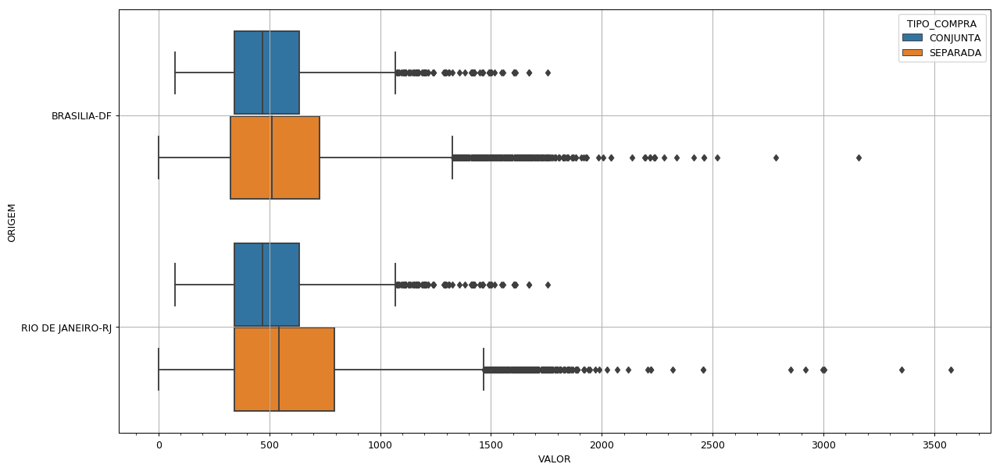

In [64]:
filtro_a = (df_passagens_7['ORIGEM'] == 'RIO DE JANEIRO-RJ') & (df_passagens_7['DESTINO'] == 'BRASILIA-DF')
filtro_b = (df_passagens_7['ORIGEM'] == 'BRASILIA-DF') & (df_passagens_7['DESTINO'] == 'RIO DE JANEIRO-RJ')

df_passagens_g = df_passagens_7[ (filtro_a | filtro_b) ].copy()

df_passagens_g['ORIGEM'] = df_passagens_g['ORIGEM'].astype(str)

ax = sns.boxplot(x='VALOR', y='ORIGEM', data=df_passagens_g, hue='TIPO_COMPRA')

ax.xaxis.set_minor_locator(matplotlib.ticker.MultipleLocator(100))
plt.grid(True)
plt.show()

In [65]:
df_passagens_g.describe()

,VALOR,TAXA,TRECHO_INT,VIAGEM_INT
count,29903.00,29903.00,29903.00,29903.00
mean,602.09,2.03,0.00,0.00
std,365.51,38.55,0.00,0.06
min,0.00,0.00,0.00,0.00
25%,333.84,0.00,0.00,0.00
50%,517.71,0.00,0.00,0.00
75%,740.02,0.00,0.00,0.00
max,3575.03,1760.90,0.00,1.00


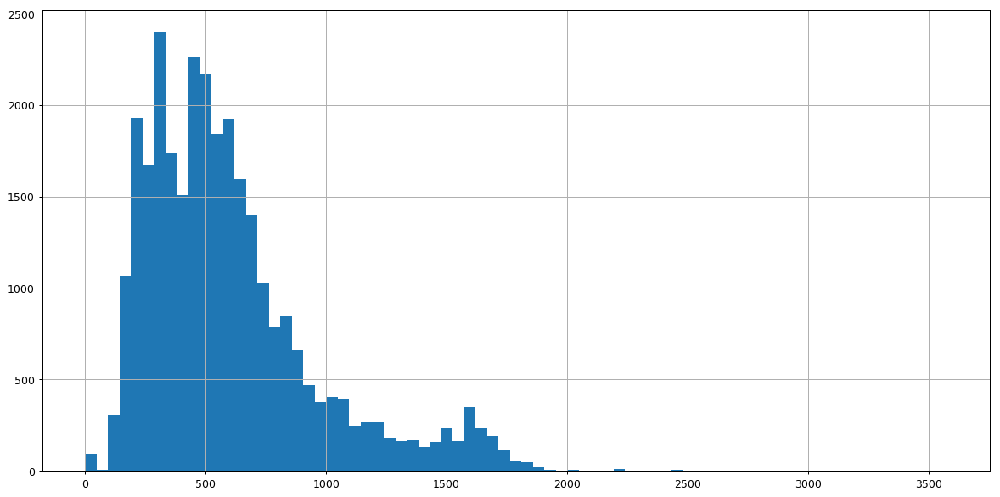

In [75]:
"""
Desenhe um histograma com os valores encontrados para o trecho mais frequente. (Considere ida ou volta)
"""
df_passagens_g['VALOR'].hist(bins=75)

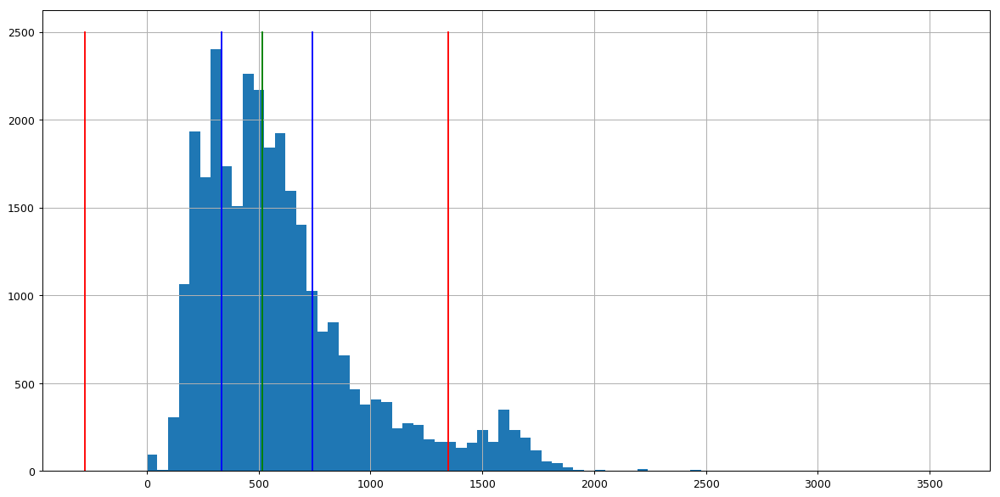

In [81]:
"""
Identifique os outliers utilizando as marcações do boxplot.

IQR = q3 - q1
limite inferior = q1 - 1.5*IQR
limite superior = q3 + 1.5*IQR
"""

q1, q2, q3 = df_passagens_g['VALOR'].quantile([.25,.5,.75])


df_passagens_g['VALOR'].hist(bins=75)

plt.plot([q2, q2], [0,2500], c='green')
plt.plot([q1, q1], [0,2500], c='blue')
plt.plot([q3, q3], [0,2500], c='blue')

iqr = q3-q1

limi = q1 - 1.5*iqr
lims = q3 + 1.5*iqr

plt.plot([limi, limi], [0,2500], c='red')
plt.plot([lims, lims], [0,2500], c='red')

In [82]:
"""
Utilize o dataframe df_viagem para incluir as informações de Órgão Solicitante e Motivo da Viagem
"""
df_viagem = pd.read_csv('dados/c04_passagens/2018_Viagem.csv.zip', sep=';', 
                        encoding='iso-8859-1', error_bad_lines=False, quotechar="\"",
                       warn_bad_lines=False)
df_viagem.head()

,Identificador do processo de viagem,Situação,Código do órgão superior,Nome do órgão superior,Código órgão solicitante,Nome órgão solicitante,CPF viajante,Nome,Cargo,Período - Data de início,Período - Data de fim,Destinos,Motivo,Valor diárias,Valor passagens,Valor outros gastos
0,13501576,Realizada,36000,MINISTERIO DA SAUDE,36201,FUNDACAO OSWALDO CRUZ,***.637.54*-**,ELIANE CALDAS DO NASCIMENTO OLIVEIRA,PESQUISADOR EM SAUDE PUBLICA,20180210,20180302,Coimbra/Portugal,"PARTICIPAÇÃO EM PROJETOS DE PESQUISA DESENVOLVIDOS PELO BLH/IFF, EM CURSOS DE PÓS-GRADUAÇÃO STRITO CENSO, APERFEIÇOAMENTO, ATUALIZAÇÃO E SENSIBILIZAÇÃO NA CAPACITAÇÃO DE SERVIDORES PROFISSIONAIS DA ÁREA DE SAÚDE, DENTRE OUTROS CURSOS TREINAMENTOS RELACIONADOS À PROMOÇÃO DO ALEITAMENTO MATERNO; PRODUÇÃO ACADÊMICA COM ARTIGOS PARA SEREM PUBLICADOS E ORIENTAÇÃO DE ALUNOS; ASSISTÊNCIA AMBULATORIAL E HOSPITALAR E REUNIÕES E PLANEJAMENTOS.",",00",",00",",00"
1,14046485,Realizada,26000,MINISTERIO DA EDUCACAO,26405,"INST.FED.DE EDUC.,CIENC.E TEC.DO CEARA",***.061.02*-**,REGINA LUCIA BEZERRA VASQUES,NaN,20180223,20180225,Meruoca/CE,"Realizar o encontro presencial da Disciplina ESPANHOL BÁSICO, no Polo de MERUOCA no dia 24/02/2018, no turno MANHÃ E TARDE","537,50","98,68",",00"
2,14108743,Realizada,26000,MINISTERIO DA EDUCACAO,26258,UNIVERSIDADE TECNOLOGICA FEDERAL DO PARANA,***.414.38*-**,JULIANA BORTOLI RODRIGUES MEES,PROFESSOR ENS BASICO TECN TECNOLOGICO,20180117,20180216,Lisboa/Portugal,"Estágio/Intercâmbio Internacional no IPPORTO PORTUGAL. Para o desenvolvimento do projeto Inovações Metodológicas na caracterização e no tratamento de resíduos agroindustriais aplicadas para o ensino da graduação de engenharia ambiental"", APROVADO no Edital PROGRAD 10/2017 para o desenvolvimento de projetos inovadores de caráter internacional no ensino na graduação, no qual consta como proponente a professora JULIANA BORTOLI RODRIGUES MEES.""",",00",",00",",00"
3,14112304,Realizada,26000,MINISTERIO DA EDUCACAO,26279,FUNDACAO UNIVERSIDADE FEDERAL DO PIAUI,***.836.65*-**,FRANCISCO DE ASSIS SINIMBU NETO,PROFESSOR ENS BASICO TECN TECNOLOGICO,20180104,20180106,Bom Jesus/PI,"o mesmo participará de solenidades de FORMATURAS DOS CURSOS REGULARES do Colégio Técnico de Bom Jesus- CTBJ, conforme programação em anexo.","487,11",",00",",00"
4,14142324,Realizada,44000,MINISTERIO DO MEIO AMBIENTE,44207,INST.CHICO MENDES DE CONSER.DA BIODIVERSIDADE,***.852.04*-**,CARINA TOSTES ABREU,ANALISTA AMBIENTAL,20180108,20180407,Honolulu/Estados Unidos da América,"Trata o presente processo da solicitação de Licença para Capacitação no exterior, com ônus limitado, Curso de inglês integral (English program for full-time students) - 240h - Academia Language School - presencial, em Honolulu/HI/USA, a ser realizado no período de 08 de janeiro de 2018 a 07 de abril de 2018, totalizando 90 dias. Conforme autorizado no processo 02070.004142/2017-02",",00",",00",",00"


In [93]:
"""
Identifique os órgãos com mais ocorrências entre os outliers.
"""
df_tmp = df_viagem[['Identificador do processo de viagem', 'Nome órgão solicitante', 'Motivo']].copy()
df_tmp['Identificador do processo de viagem'] = df_tmp['Identificador do processo de viagem'].astype(np.float64)

In [96]:
df_passagens.head()

,Identificador do processo de viagem,Meio de transporte,País - Origem ida,UF - Origem ida,Cidade - Origem ida,País - Destino ida,UF - Destino ida,Cidade - Destino ida,País - Origem volta,UF - Origem volta,Cidade - Origem volta,Pais - Destino volta,UF - Destino volta,Cidade - Destino volta,Valor da passagem,Taxa de serviço
0,14046485,Rodoviário,Brasil,Ceará,Fortaleza,Brasil,Ceará,Sobral,None,None,None,None,None,None,"40,95","13,51"
1,14046485,Rodoviário,Brasil,Ceará,Sobral,Brasil,Ceará,Fortaleza,None,None,None,None,None,None,"33,25","10,97"
2,14166390,Aéreo,Brasil,Paraná,Londrina,Brasil,Mato Grosso,Sinop,None,None,None,None,None,None,"518,09",",00"
3,14166390,Aéreo,Brasil,Mato Grosso,Sinop,Brasil,Paraná,Londrina,None,None,None,None,None,None,"665,38",",00"
4,14201345,Aéreo,Brasil,Paraná,Curitiba,Brasil,Rio Grande do Sul,Porto Alegre,None,None,None,None,None,None,"369,30",",00"


In [95]:
df_completo = df_passagens_g.copy()
df_completo['ID_VIAGEM'] = df_completo['ID_VIAGEM'].astype(np.float64)

df_completo = pd.merge(
    df_completo, 
    df_tmp[['Identificador do processo de viagem', 'Nome órgão solicitante', 'Motivo']],
    left_on='ID_VIAGEM', right_on='Identificador do processo de viagem', how='left'
)

del(df_completo['Identificador do processo de viagem'])
df_completo = df_completo.rename(columns={'Nome órgão solicitante': 'ORGAO_SOLICITANTE', 'Motivo':'MOTIVO'})
df_completo.head()

,ID_VIAGEM,ORIGEM,DESTINO,VALOR,TAXA,TRECHO_INT,VIAGEM_INT,TIPO_TRECHO,TIPO_COMPRA,MEIO_TRANSPORTE,ORGAO_SOLICITANTE,MOTIVO
0,14271222.00,BRASILIA-DF,RIO DE JANEIRO-RJ,143.12,0.00,0,0,IDA,CONJUNTA,AEREO,COMANDO DA AERONAUTICA,Passagem de Chefia do SERIPA 3.
1,14271222.00,RIO DE JANEIRO-RJ,BRASILIA-DF,143.12,0.00,0,0,VOLTA,CONJUNTA,AEREO,COMANDO DA AERONAUTICA,Passagem de Chefia do SERIPA 3.
2,14349301.00,RIO DE JANEIRO-RJ,BRASILIA-DF,1469.80,0.00,0,0,IDA,SEPARADA,AEREO,MINISTERIO DAS RELACOES EXTERIORES - UNIDADES COM VÍNCULO DIRETO,"Remoção para SERE, conforme BS nº 195, de 11/10/2017"
3,14391133.00,RIO DE JANEIRO-RJ,BRASILIA-DF,102.47,0.00,0,0,IDA,CONJUNTA,AEREO,FUNDACAO UNIVERSIDADE DE BRASILIA,"Participação em Banca de defesa de Dissertação do aluno Hécio Wanderley de Souza Almeida, dia 27/02/18."
4,14391133.00,BRASILIA-DF,RIO DE JANEIRO-RJ,102.47,0.00,0,0,VOLTA,CONJUNTA,AEREO,FUNDACAO UNIVERSIDADE DE BRASILIA,"Participação em Banca de defesa de Dissertação do aluno Hécio Wanderley de Souza Almeida, dia 27/02/18."


In [87]:
df_completo[df_completo['VALOR'] > lims]['Nome órgão solicitante'].value_counts()

COMANDO DA AERONAUTICA                                                         116
MINISTERIO DA EDUCACAO - UNIDADES COM VÍNCULO DIRETO                            95
PRESIDENCIA DA REPUBLICA - UNIDADES COM VÍNCULO DIRETO                          87
COMANDO DO EXERCITO                                                             84
INST.NACIONAL DE EST.E PESQUISAS EDUCACIONAIS                                   67
COMISSAO NACIONAL DE ENERGIA NUCLEAR                                            58
AGENCIA NACIONAL DO PETROLEO                                                    51
MINISTERIO DA FAZENDA - UNIDADES COM VÍNCULO DIRETO                             51
MINISTERIO DA SAUDE - UNIDADES COM VÍNCULO DIRETO                               50
MINIST.DA CIENCIA,TECNOL.,INOV.E COMUNICACOES - UNIDADES COM VÍNCULO DIRETO     49
MINISTERIO DAS CIDADES - UNIDADES COM VÍNCULO DIRETO                            48
FUND.INST.BRASILEIRO DE GEOG.E ESTATISTICA                                      45
MINI

___
__Material produzido para o curso__:
* Introdução à Análise de Dados com Python

__Autor__:
* Fernando Sola Pereira

__Revisão__:
* 1.1